# Amazon Fine Food Reviews Analysis


Data Source: https://www.kaggle.com/snap/amazon-fine-food-reviews <br>

EDA: https://nycdatascience.com/blog/student-works/amazon-fine-foods-visualization/


The Amazon Fine Food Reviews dataset consists of reviews of fine foods from Amazon.<br>

Number of reviews: 568,454<br>
Number of users: 256,059<br>
Number of products: 74,258<br>
Timespan: Oct 1999 - Oct 2012<br>
Number of Attributes/Columns in data: 10 

Attribute Information:

1. Id
2. ProductId - unique identifier for the product
3. UserId - unqiue identifier for the user
4. ProfileName
5. HelpfulnessNumerator - number of users who found the review helpful
6. HelpfulnessDenominator - number of users who indicated whether they found the review helpful or not
7. Score - rating between 1 and 5
8. Time - timestamp for the review
9. Summary - brief summary of the review
10. Text - text of the review


#### Objective:
Given a review, determine whether the review is positive (rating of 4 or 5) or negative (rating of 1 or 2).

<br>
[Q] How to determine if a review is positive or negative?<br>
<br> 
[Ans] We could use Score/Rating. A rating of 4 or 5 can be cosnidered as a positive review. A rating of 1 or 2 can be considered as negative one. A review of rating 3 is considered nuetral and such reviews are ignored from our analysis. This is an approximate and proxy way of determining the polarity (positivity/negativity) of a review.




# [1]. Reading Data

## [1.1] Loading the data

The dataset is available in two forms
1. .csv file
2. SQLite Database

In order to load the data, We have used the SQLITE dataset as it is easier to query the data and visualise the data efficiently.
<br> 

Here as we only want to get the global sentiment of the recommendations (positive or negative), we will purposefully ignore all Scores equal to 3. If the score is above 3, then the recommendation wil be set to "positive". Otherwise, it will be set to "negative".

In [102]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")


import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

In [103]:
# using SQLite Table to read data.
con = sqlite3.connect('database.sqlite') 

# filtering only positive and negative reviews i.e. 
# not taking into consideration those reviews with Score=3
# SELECT * FROM Reviews WHERE Score != 3 LIMIT 500000, will give top 500000 data points
# you can change the number to any other number based on your computing power

# filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 LIMIT 500000""", con) 
# for tsne assignment you can take 5k data points

filtered_data = pd.read_sql_query(""" SELECT * FROM Reviews WHERE Score != 3 LIMIT 60000""", con) 

# Give reviews with Score>3 a positive rating(1), and reviews with a score<3 a negative rating(0).
def partition(x):
    if x < 3:
        return 0
    return 1

#changing reviews with score less than 3 to be positive and vice-versa
actualScore = filtered_data['Score']
positiveNegative = actualScore.map(partition) 
filtered_data['Score'] = positiveNegative
print("Number of data points in our data", filtered_data.shape)
filtered_data.head(3)

Number of data points in our data (60000, 10)


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,1,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,0,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,1,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...


In [104]:
display = pd.read_sql_query("""
SELECT UserId, ProductId, ProfileName, Time, Score, Text, COUNT(*)
FROM Reviews
GROUP BY UserId
HAVING COUNT(*)>1
""", con)

In [105]:
print(display.shape)
display.head()

(80668, 7)


,UserId,ProductId,ProfileName,Time,Score,Text,COUNT(*)
0,#oc-R115TNMSPFT9I7,B005ZBZLT4,Breyton,1331510400,2,Overall its just OK when considering the price...,2
1,#oc-R11D9D7SHXIJB9,B005HG9ESG,"Louis E. Emory ""hoppy""",1342396800,5,"My wife has recurring extreme muscle spasms, u...",3
2,#oc-R11DNU2NBKQ23Z,B005ZBZLT4,Kim Cieszykowski,1348531200,1,This coffee is horrible and unfortunately not ...,2
3,#oc-R11O5J5ZVQE25C,B005HG9ESG,Penguin Chick,1346889600,5,This will be the bottle that you grab from the...,3
4,#oc-R12KPBODL2B5ZD,B007OSBEV0,Christopher P. Presta,1348617600,1,I didnt like this coffee. Instead of telling y...,2


In [106]:
display[display['UserId']=='AZY10LLTJ71NX']

,UserId,ProductId,ProfileName,Time,Score,Text,COUNT(*)
80638,AZY10LLTJ71NX,B001ATMQK2,"undertheshrine ""undertheshrine""",1296691200,5,I bought this 6 pack because for the price tha...,5


In [107]:
display['COUNT(*)'].sum()

393063

#  [2] Exploratory Data Analysis

## [2.1] Data Cleaning: Deduplication

It is observed (as shown in the table below) that the reviews data had many duplicate entries. Hence it was necessary to remove duplicates in order to get unbiased results for the analysis of the data.  Following is an example:

In [7]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND UserId="AR5J8UI46CURR"
ORDER BY ProductID
""", con)
display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,78445,B000HDL1RQ,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
1,138317,B000HDOPYC,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
2,138277,B000HDOPYM,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
3,73791,B000HDOPZG,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...
4,155049,B000PAQ75C,AR5J8UI46CURR,Geetha Krishnan,2,2,5,1199577600,LOACKER QUADRATINI VANILLA WAFERS,DELICIOUS WAFERS. I FIND THAT EUROPEAN WAFERS ...


As it can be seen above that same user has multiple reviews with same values for HelpfulnessNumerator, HelpfulnessDenominator, Score, Time, Summary and Text and on doing analysis it was found that <br>
<br> 
ProductId=B000HDOPZG was Loacker Quadratini Vanilla Wafer Cookies, 8.82-Ounce Packages (Pack of 8)<br>
<br> 
ProductId=B000HDL1RQ was Loacker Quadratini Lemon Wafer Cookies, 8.82-Ounce Packages (Pack of 8) and so on<br>

It was inferred after analysis that reviews with same parameters other than ProductId belonged to the same product just having different flavour or quantity. Hence in order to reduce redundancy it was decided to eliminate the rows having same parameters.<br>

The method used for the same was that we first sort the data according to ProductId and then just keep the first similar product review and delelte the others. for eg. in the above just the review for ProductId=B000HDL1RQ remains. This method ensures that there is only one representative for each product and deduplication without sorting would lead to possibility of different representatives still existing for the same product.

In [8]:
#Sorting data according to ProductId in ascending order
sorted_data=filtered_data.sort_values('ProductId', axis=0, ascending=True, inplace=False, kind='quicksort', na_position='last')

In [9]:
#Deduplication of entries
final=sorted_data.drop_duplicates(subset={"UserId","ProfileName","Time","Text"}, keep='first', inplace=False)
final.shape

(54458, 10)

In [10]:
#Checking to see how much % of data still remains
(final['Id'].size*1.0)/(filtered_data['Id'].size*1.0)*100

90.76333333333334

<b>Observation:-</b> It was also seen that in two rows given below the value of HelpfulnessNumerator is greater than HelpfulnessDenominator which is not practically possible hence these two rows too are removed from calcualtions

In [11]:
display= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score != 3 AND Id=44737 OR Id=64422
ORDER BY ProductID
""", con)

display.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,64422,B000MIDROQ,A161DK06JJMCYF,"J. E. Stephens ""Jeanne""",3,1,5,1224892800,Bought This for My Son at College,My son loves spaghetti so I didn't hesitate or...
1,44737,B001EQ55RW,A2V0I904FH7ABY,Ram,3,2,4,1212883200,Pure cocoa taste with crunchy almonds inside,It was almost a 'love at first bite' - the per...


In [12]:
final=final[final.HelpfulnessNumerator<=final.HelpfulnessDenominator]

In [13]:
#Before starting the next phase of preprocessing lets see the number of entries left
print(final.shape)

#How many positive and negative reviews are present in our dataset?
final['Score'].value_counts()

(54456, 10)


1    45572
0     8884
Name: Score, dtype: int64

#  [3] Preprocessing

## [3.1].  Preprocessing Review Text

Now that we have finished deduplication our data requires some preprocessing before we go on further with analysis and making the prediction model.

Hence in the Preprocessing phase we do the following in the order below:-

1. Begin by removing the html tags
2. Remove any punctuations or limited set of special characters like , or . or # etc.
3. Check if the word is made up of english letters and is not alpha-numeric
4. Check to see if the length of the word is greater than 2 (as it was researched that there is no adjective in 2-letters)
5. Convert the word to lowercase
6. Remove Stopwords
7. Finally Snowball Stemming the word (it was obsereved to be better than Porter Stemming)<br>

After which we collect the words used to describe positive and negative reviews

In [14]:
# printing some random reviews
sent_0 = final['Text'].values[0]
print(sent_0)
print("="*50)

sent_1000 = final['Text'].values[1000]
print(sent_1000)
print("="*50)

sent_1500 = final['Text'].values[1500]
print(sent_1500)
print("="*50)

sent_4900 = final['Text'].values[4900]
print(sent_4900)
print("="*50)

Our dogs just love them.  I saw them in a pet store and a tag was attached regarding them being made in China and it satisfied me that they were safe.
My whole family loves this sauce. I use it primarily to recreate a dish we had in Maui. It adds a wonderful sweet and spicy flavor to just about any sauce. Service on this order was spectacular. Several bottles arrived broken and replacements were received within days. Amazon service was fast, easy and reliable. I love Amazon. Also, there are many recipes that you can look up using this sauce that a very good. It goes spectaculary with coconut milk, vegetables, chicken or shrimp and pasta. We love it.
My husband is a paraplegic and was having UTIs constantly.  Since he started drinking a cup of this tea every morning, he hasn't had a UTI for a year.
THIS BREAD MIX IS THE CLOSEST THING TO REGULAR BREAD I HAVE FOUND. EASY TO MAKE IN MY BREAD MACHINE.


In [15]:
# remove urls from text python: https://stackoverflow.com/a/40823105/4084039
sent_0 = re.sub(r"http\S+", "", sent_0)
sent_1000 = re.sub(r"http\S+", "", sent_1000)
sent_150 = re.sub(r"http\S+", "", sent_1500)
sent_4900 = re.sub(r"http\S+", "", sent_4900)

print(sent_0)

Our dogs just love them.  I saw them in a pet store and a tag was attached regarding them being made in China and it satisfied me that they were safe.


In [16]:
# https://stackoverflow.com/questions/16206380/python-beautifulsoup-how-to-remove-all-tags-from-an-element
from bs4 import BeautifulSoup

soup = BeautifulSoup(sent_0, 'lxml')
text = soup.get_text()
print(text)
print("="*50)

soup = BeautifulSoup(sent_1000, 'lxml')
text = soup.get_text()
print(text)
print("="*50)

soup = BeautifulSoup(sent_1500, 'lxml')
text = soup.get_text()
print(text)
print("="*50)

soup = BeautifulSoup(sent_4900, 'lxml')
text = soup.get_text()
print(text)

Our dogs just love them.  I saw them in a pet store and a tag was attached regarding them being made in China and it satisfied me that they were safe.
My whole family loves this sauce. I use it primarily to recreate a dish we had in Maui. It adds a wonderful sweet and spicy flavor to just about any sauce. Service on this order was spectacular. Several bottles arrived broken and replacements were received within days. Amazon service was fast, easy and reliable. I love Amazon. Also, there are many recipes that you can look up using this sauce that a very good. It goes spectaculary with coconut milk, vegetables, chicken or shrimp and pasta. We love it.
My husband is a paraplegic and was having UTIs constantly.  Since he started drinking a cup of this tea every morning, he hasn't had a UTI for a year.
THIS BREAD MIX IS THE CLOSEST THING TO REGULAR BREAD I HAVE FOUND. EASY TO MAKE IN MY BREAD MACHINE.


In [17]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [18]:
sent_1500 = decontracted(sent_1500)
print(sent_1500)
print("="*50)

My husband is a paraplegic and was having UTIs constantly.  Since he started drinking a cup of this tea every morning, he has not had a UTI for a year.


In [19]:
#remove words with numbers python: https://stackoverflow.com/a/18082370/4084039
sent_0 = re.sub("\S*\d\S*", "", sent_0).strip()
print(sent_0)

Our dogs just love them.  I saw them in a pet store and a tag was attached regarding them being made in China and it satisfied me that they were safe.


In [20]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent_1500 = re.sub('[^A-Za-z0-9]+', ' ', sent_1500)
print(sent_1500)

My husband is a paraplegic and was having UTIs constantly Since he started drinking a cup of this tea every morning he has not had a UTI for a year 


In [21]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
# <br /><br /> ==> after the above steps, we are getting "br br"
# we are including them into stop words list
# instead of <br /> if we have <br/> these tags would have revmoved in the 1st step

stopwords= set(['br', 'the', 'i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"])

In [22]:
# Combining all the above stundents 
from tqdm import tqdm
preprocessed_reviews = []
# tqdm is for printing the status bar
for sentance in tqdm(final['Text'].values):
    sentance = re.sub(r"http\S+", "", sentance)
    sentance = BeautifulSoup(sentance, 'lxml').get_text()
    sentance = decontracted(sentance)
    sentance = re.sub("\S*\d\S*", "", sentance).strip()
    sentance = re.sub('[^A-Za-z]+', ' ', sentance)
    # https://gist.github.com/sebleier/554280
    sentance = ' '.join(e.lower() for e in sentance.split() if e.lower() not in stopwords)
    preprocessed_reviews.append(sentance.strip())

100%|██████████| 54456/54456 [00:28<00:00, 1886.10it/s]


In [23]:
preprocessed_reviews[1500]

'husband paraplegic utis constantly since started drinking cup tea every morning not uti year'

# [4] Featurization

# [4.1] BAG OF WORDS

In [25]:
#BoW
count_vect = CountVectorizer() #in scikit-learn
count_vect.fit(preprocessed_reviews)
print("some feature names ", count_vect.get_feature_names()[:10])
print('='*50)

final_counts = count_vect.transform(preprocessed_reviews)
print("the type of count vectorizer ",type(final_counts))
print("the shape of out text BOW vectorizer ",final_counts.get_shape())
print("the number of unique words ", final_counts.get_shape()[1])

some feature names  ['aa', 'aahhhs', 'aback', 'abandon', 'abates', 'abbott', 'abby', 'abdominal', 'abiding', 'ability']
the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (4986, 12997)
the number of unique words  12997


# [4.2] Bi-Grams and n-Grams 

In [26]:
#bi-gram, tri-gram and n-gram

#removing stop words like "not" should be avoided before building n-grams
# count_vect = CountVectorizer(ngram_range=(1,2))
# please do read the CountVectorizer documentation http://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.CountVectorizer.html

# you can choose these numebrs min_df=10, max_features=5000, of your choice
count_vect = CountVectorizer(ngram_range=(1,2), min_df=10, max_features=5000)
final_bigram_counts = count_vect.fit_transform(preprocessed_reviews)
print("the type of count vectorizer ",type(final_bigram_counts))
print("the shape of out text BOW vectorizer ",final_bigram_counts.get_shape())
print("the number of unique words including both unigrams and bigrams ", final_bigram_counts.get_shape()[1])

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text BOW vectorizer  (4986, 3144)
the number of unique words including both unigrams and bigrams  3144


# [4.3] TF-IDF

In [27]:
tf_idf_vect = TfidfVectorizer(ngram_range=(1,2), min_df=10)
tf_idf_vect.fit(preprocessed_reviews)
print("some sample features(unique words in the corpus)",tf_idf_vect.get_feature_names()[0:10])
print('='*50)

final_tf_idf = tf_idf_vect.transform(preprocessed_reviews)
print("the type of count vectorizer ",type(final_tf_idf))
print("the shape of out text TFIDF vectorizer ",final_tf_idf.get_shape())
print("the number of unique words including both unigrams and bigrams ", final_tf_idf.get_shape()[1])

some sample features(unique words in the corpus) ['ability', 'able', 'able find', 'able get', 'absolute', 'absolutely', 'absolutely delicious', 'absolutely love', 'absolutely no', 'according']
the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the shape of out text TFIDF vectorizer  (4986, 3144)
the number of unique words including both unigrams and bigrams  3144


# [4.4] Word2Vec

In [28]:
# Train your own Word2Vec model using your own text corpus
i=0
list_of_sentance=[]
for sentance in preprocessed_reviews:
    list_of_sentance.append(sentance.split())

In [42]:
# Using Google News Word2Vectors

# in this project we are using a pretrained model by google
# its 3.3G file, once you load this into your memory 
# it occupies ~9Gb, so please do this step only if you have >12G of ram
# we will provide a pickle file wich contains a dict , 
# and it contains all our courpus words as keys and  model[word] as values
# To use this code-snippet, download "GoogleNews-vectors-negative300.bin" 
# from https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit
# it's 1.9GB in size.


# http://kavita-ganesan.com/gensim-word2vec-tutorial-starter-code/#.W17SRFAzZPY
# you can comment this whole cell
# or change these varible according to your need

is_your_ram_gt_16g=False
want_to_use_google_w2v = False
want_to_train_w2v = True

if want_to_train_w2v:
    # min_count = 5 considers only words that occured atleast 5 times
    w2v_model=Word2Vec(list_of_sentance,min_count=5,size=50, workers=4)
    print(w2v_model.wv.most_similar('great'))
    print('='*50)
    print(w2v_model.wv.most_similar('worst'))
    
elif want_to_use_google_w2v and is_your_ram_gt_16g:
    if os.path.isfile('GoogleNews-vectors-negative300.bin'):
        w2v_model=KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)
        print(w2v_model.wv.most_similar('great'))
        print(w2v_model.wv.most_similar('worst'))
    else:
        print("you don't have gogole's word2vec file, keep want_to_train_w2v = True, to train your own w2v ")

[('snack', 0.9951335191726685), ('calorie', 0.9946465492248535), ('wonderful', 0.9946032166481018), ('excellent', 0.9944332838058472), ('especially', 0.9941144585609436), ('baked', 0.9940600395202637), ('salted', 0.994047224521637), ('alternative', 0.9937226176261902), ('tasty', 0.9936816692352295), ('healthy', 0.9936649799346924)]
[('varieties', 0.9994194507598877), ('become', 0.9992934465408325), ('popcorn', 0.9992750883102417), ('de', 0.9992610216140747), ('miss', 0.9992451071739197), ('melitta', 0.999218761920929), ('choice', 0.9992102384567261), ('american', 0.9991837739944458), ('beef', 0.9991780519485474), ('finish', 0.9991567134857178)]


In [36]:
w2v_words = list(w2v_model.wv.vocab)
print("number of words that occured minimum 5 times ",len(w2v_words))
print("sample words ", w2v_words[0:50])

number of words that occured minimum 5 times  3817
sample words  ['product', 'available', 'course', 'total', 'pretty', 'stinky', 'right', 'nearby', 'used', 'ca', 'not', 'beat', 'great', 'received', 'shipment', 'could', 'hardly', 'wait', 'try', 'love', 'call', 'instead', 'removed', 'easily', 'daughter', 'designed', 'printed', 'use', 'car', 'windows', 'beautifully', 'shop', 'program', 'going', 'lot', 'fun', 'everywhere', 'like', 'tv', 'computer', 'really', 'good', 'idea', 'final', 'outstanding', 'window', 'everybody', 'asks', 'bought', 'made']


# [4.4.1] Converting text into vectors using Avg W2V, TFIDF-W2V

#### [4.4.1.1] Avg W2V

In [38]:
# average Word2Vec
# compute average word2vec for each review.
sent_vectors = []; # the avg-w2v for each sentence/review is stored in this list
for sent in tqdm(list_of_sentance): # for each review/sentence
    sent_vec = np.zeros(50) # as word vectors are of zero length 50, you might need to change this to 300 if you use google's w2v
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)
print(len(sent_vectors))
print(len(sent_vectors[0]))

100%|████████████████████████████████████████████████████████████████████████████| 4986/4986 [00:03<00:00, 1330.47it/s]


4986
50


#### [4.4.1.2] TFIDF weighted W2V

In [39]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
model = TfidfVectorizer()
tf_idf_matrix = model.fit_transform(preprocessed_reviews)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(model.get_feature_names(), list(model.idf_)))

In [41]:
# TF-IDF weighted Word2Vec
tfidf_feat = model.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors = []; # the tfidf-w2v for each sentence/review is stored in this list
row=0;
for sent in tqdm(list_of_sentance): # for each review/sentence 
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words and word in tfidf_feat:
            vec = w2v_model.wv[word]
#             tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

100%|█████████████████████████████████████████████████████████████████████████████| 4986/4986 [00:20<00:00, 245.63it/s]


#  Obtaining the Required DataFrame:

In [24]:
type(preprocessed_reviews)

list

In [25]:
print(final.shape)

(54456, 10)


We obtain a list at the end of all the Preprocessing whereas the data frame that we obtained at the end was named 
'final'. Initially I considered 60K datapoints to work upon which got reduced to approx. 54K datapoints after all 
the text processing and data deduplication.

Out of these 54K datapoints in total we will consider only 50K points to be applied to the K-Means Clustering whereas only 5K datapoints will be used in the case of Hierarchical Clustering (Agglomerative Clustering in our case) and Density Based Clustering Algorithm of DBSCAN.

In [26]:
final['Preprocessed_Reviews'] = preprocessed_reviews

Basically I have taken the entire list and added the list as a column to the entire dataframe, such that each value
corresponds to a row in the dataframe. 

In [27]:
final.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,Preprocessed_Reviews
22621,24751,2734888454,A1C298ITT645B6,Hugh G. Pritchard,0,0,1,1195948800,Dog Lover Delites,Our dogs just love them. I saw them in a pet ...,dogs love saw pet store tag attached regarding...
22620,24750,2734888454,A13ISQV0U9GZIC,Sandikaye,1,1,0,1192060800,made in china,My dogs loves this chicken but its a product f...,dogs loves chicken product china wont buying a...
2546,2774,B00002NCJC,A196AJHU9EASJN,Alex Chaffee,0,0,1,1282953600,thirty bucks?,Why is this $[...] when the same product is av...,product available victor traps unreal course t...
2547,2775,B00002NCJC,A13RRPGE79XFFH,reader48,0,0,1,1281052800,Flies Begone,We have used the Victor fly bait for 3 seasons...,used victor fly bait seasons ca not beat great...
1146,1245,B00002Z754,A29Z5PI9BW2PU3,Robbie,7,7,1,961718400,Great Product,This was a really good idea and the final prod...,really good idea final product outstanding use...


Now I have a total of approx. 54K rows in the dataframe called 'final', of which I will consider only 50K rows to
be applied to the K-Means Clustering Algorithm & to the Agglomerative & DBSCAN based Clustering algorithms. 

Also here you have the Unix Timestamp in the data, which is basically the time when the review was posted. This would have helped us to carry out Time Based Split of the data into Train, CV and Test in the case of the Supervised Learning schemes of Classification & Regression, but we do not do so in the case of Unsupervised Learning schemes.

# Further Data Processing :- 

First I will remove all the useless columns from my dataframe. The only columns that we are concerned about here in 
this case is the 'Preprocessed_Reviews' (Without carrying out any Feature Engineering). Remaining columns 
in the dataframe are of no use to us. 

Note :- Even 'Score' as a column is of no use to us because 'Score' basically refers to our class labels, something which are of no use to us when we are carrying out the Unsupervised Method of Clustering.

In [28]:
df = final[['Preprocessed_Reviews']]

In [29]:
df.head()

,Preprocessed_Reviews
22621,dogs love saw pet store tag attached regarding...
22620,dogs loves chicken product china wont buying a...
2546,product available victor traps unreal course t...
2547,used victor fly bait seasons ca not beat great...
1146,really good idea final product outstanding use...


# [5.1] Applying K-Means Clustering :-

In [30]:
#Obtaining the 50K rows to be worked upon

K_Means_df = df[:50000]

In [54]:
Reviews_list = []

#Each Review is appened in a list.
for i in K_Means_df['Preprocessed_Reviews']:
    Reviews_list.append(i)

# [5.1.1] SET 1 : Applying K-Means Clustering on BOW :-

In [32]:
count_vect = CountVectorizer()
BOW_K_vectorized = count_vect.fit_transform(K_Means_df['Preprocessed_Reviews']) 

#fit_transform internally considers the parameters that will be used for transforming the data from the text to a 
#numerical vector and then carries out the Transformation

In [33]:
BOW_K_vectorized.shape

(50000, 41655)

# Hyperparameter Tuning on the BOW Representation :- 

In order to carry out the Hyperparameter Tuning we need to work upon the Number of Clusters that we should obtain(K) after initializing K Centroids, and this is basically taken in the range of (2,50). This Hyperparameter Tuning is carried out by plotting the inertia (Loss Function for K-means vs the Count of Clusters).

Again, here we take n_init ie the number of initializations to be equal to 10 ie the initialization will be carried out 10 times and max_iter=200. This means that the iterations keep occuring till the defined tolerance level is achieved ie. the distance between the final centroid and the semi-final centroid is > tolerance.

In [34]:
K_hyperparam =[]

for i in range(2,50,5):
    K_hyperparam.append(i)

In [56]:
#Importing the Required Packages for K-Means

from sklearn.cluster import KMeans
from wordcloud import WordCloud
import matplotlib.pyplot as plt  
from tqdm import tqdm

In [36]:
BOW_inertia = []

for k in tqdm(K_hyperparam):
    BOW_KMModel = KMeans(n_clusters=k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                      random_state=0,n_jobs=-1,algorithm='auto')
    # I have taken n_jobs=-1 so as to parallelise the entire execution. A specification of -1 in this scenario
    # means to use all the processors that are available.
    
    BOW_KMModel.fit(BOW_K_vectorized)
    BOW_squared_distance_sum = BOW_KMModel.inertia_
    BOW_inertia.append(BOW_squared_distance_sum)    

100%|██████████| 10/10 [3:13:52<00:00, 1337.33s/it] 


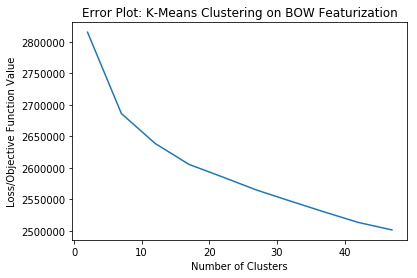

In [37]:
#Plotting the Values of Inertia (Objectve/Loss Function) for different values of K:-

plt.plot(K_hyperparam,BOW_inertia)

plt.xlabel('Number of Clusters')
plt.ylabel('Loss/Objective Function Value')
plt.title('Error Plot: K-Means Clustering on BOW Featurization')

plt.show()

Here you are obtaining the Best Value of K by plotting the Loss Function for K-Means vs the Number of Clusters. This best value is basically obtained by the Elbow Plot and finding the value of K where the first bend in the curve actually begins.

As we see here, K=7 is a good value to be taken for the n_clusters as a parameter in KMeans.

In [38]:
BOW_optimal_k=7

# [5.1.2] Wordclouds of Clusters obtained after applying K-Means on BOW :-

In [39]:
import time
start = time.time()

#Training our Data on the Final BOW Model obtained on K-Means
BOW_KMeans_final = KMeans(n_clusters=BOW_optimal_k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                          random_state=0,n_jobs=-1,algorithm='auto')
BOW_KMeans_final.fit(BOW_K_vectorized)

end = time.time()
print("Time consumed (in min) in Training the model on the Optimal K using BOW Featurization "
       , np.round((end - start)/60,2))

Time consumed (in min) in Training the model on the Optimal K using BOW Featurization  19.73


<b> <font color="black"> Function to obtain the Cluster Value Indices & Cluster Length given the Final Model & Cluster & Label:- </font> </b>

In [49]:
def Review_Cluster(final_data,k,cluster_name):
    
    for i,j in enumerate(final_data.labels_):
        if j==k:
            cluster_name.append(i)
    cluster_length = len(cluster_name)
    return cluster_name,cluster_length

<b> <font color="black"> Calling the Review_Cluster() Function on BOW Model:- </font> </b>

In [41]:
BOW_C0 = []
BOW_C1 = []
BOW_C2 = []
BOW_C3 = []
BOW_C4 = []
BOW_C5 = []
BOW_C6 = []

BOW_indices_C0,BOW_length_C0 = Review_Cluster(BOW_KMeans_final,0,BOW_C0)
BOW_indices_C1,BOW_length_C1 = Review_Cluster(BOW_KMeans_final,1,BOW_C1)
BOW_indices_C2,BOW_length_C2 = Review_Cluster(BOW_KMeans_final,2,BOW_C2)
BOW_indices_C3,BOW_length_C3 = Review_Cluster(BOW_KMeans_final,3,BOW_C3)
BOW_indices_C4,BOW_length_C4 = Review_Cluster(BOW_KMeans_final,4,BOW_C4)
BOW_indices_C5,BOW_length_C5 = Review_Cluster(BOW_KMeans_final,5,BOW_C5)
BOW_indices_C6,BOW_length_C6 = Review_Cluster(BOW_KMeans_final,6,BOW_C6)

<b> <font color="black"> Function to obtain the WordCloud for the Featurization given the Relevant Cluster Indices :- </font> </b>

In [52]:
def Show_Wordcloud(clustered_indices):
    reviews_in_cluster = set()
    empty_str = ' '
    
    for i in clustered_indices:
        reviews_in_cluster.add(Reviews_list[i])
    
    reviews_string = empty_str.join(reviews_in_cluster)
    
    wordcloud_featurization = WordCloud(width = 1100, height = 600, background_color ='black',  
                                        min_font_size =8).generate(reviews_string)

    # Display the generated image:
    plt.figure(figsize = (25, 15), facecolor = None) 
    plt.imshow(wordcloud_featurization)
    plt.axis("off")
    plt.show()

<b> <font color="black"> Obtaining Word Clouds for the Individual Clusters for BOW Featurization :- </font> </b>

Here it is to be noted that the Cluster Labelling over here starts from 0 and hence the labels for the 7 clusters will be [0-6].

Number of Reviews Classified into Cluster 0: 32630
 
Cluster 0 obtained by BOW Featurization:


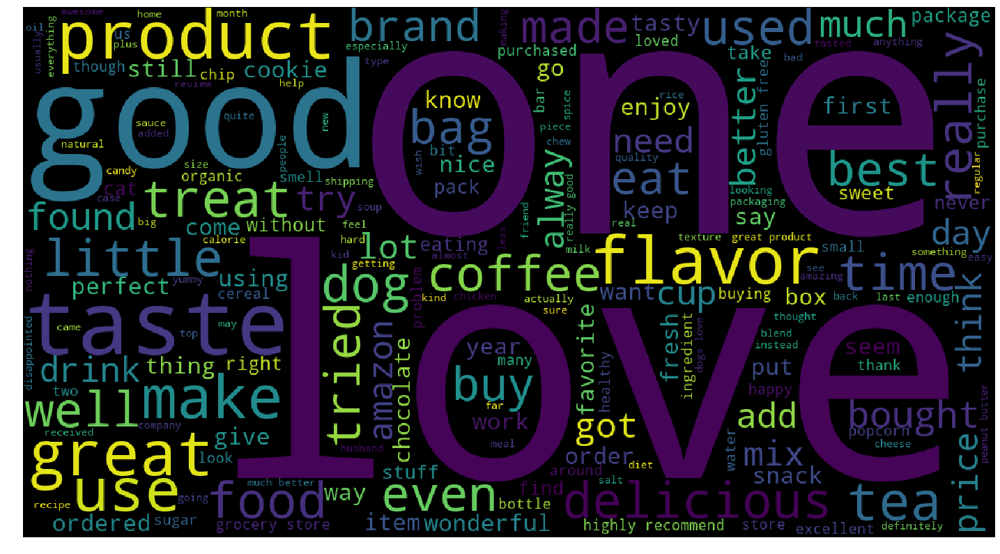

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by BOW Featurization : 0.13


In [85]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(BOW_length_C0))
print(" ")
print("Cluster 0 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C0)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by BOW Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 1283
 
Cluster 1 obtained by BOW Featurization:


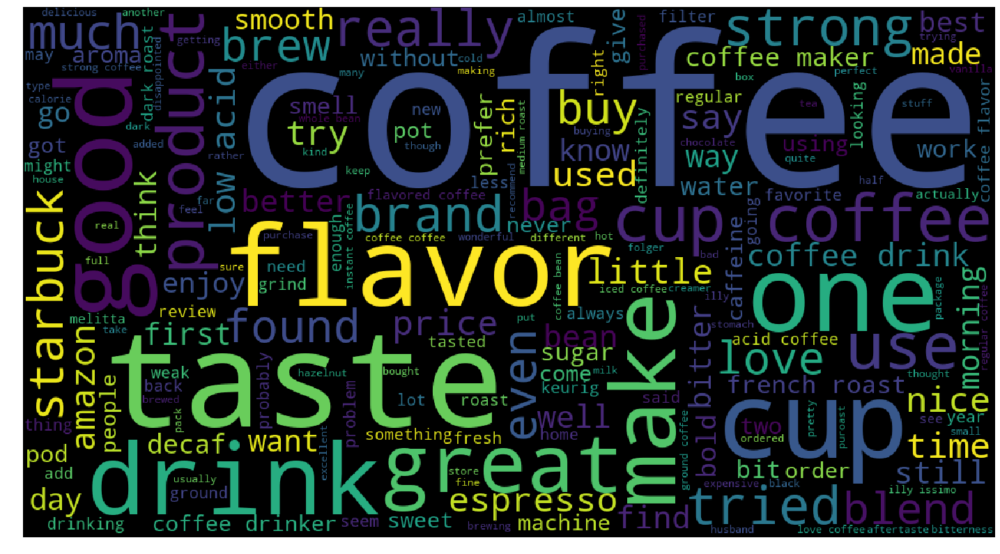

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by BOW Featurization :  0.04


In [86]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(BOW_length_C1))
print(" ")
print("Cluster 1 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C1)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by BOW Featurization : "
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 2: 11633
 
Cluster 2 obtained by BOW Featurization:


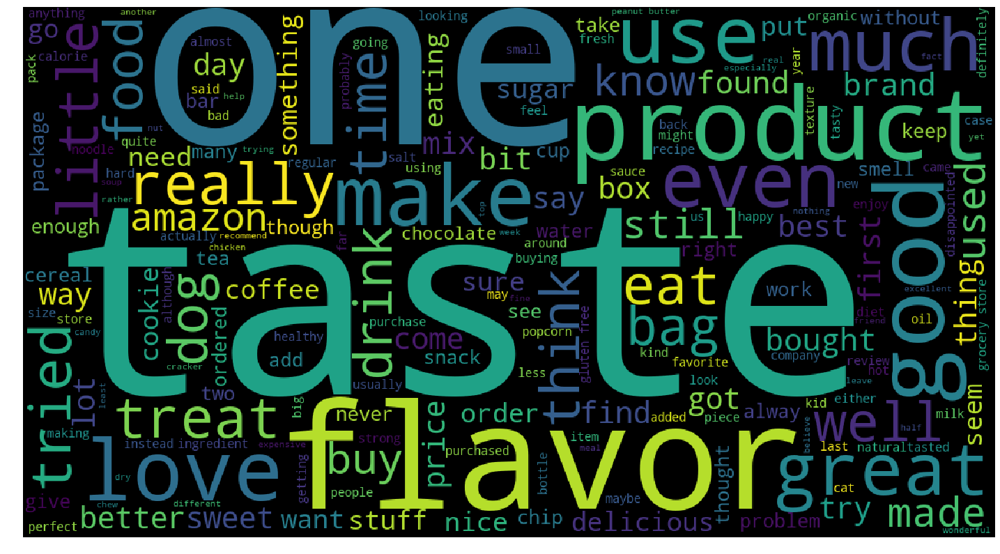

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by BOW Featurization :  0.1


In [87]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 2: " + str(BOW_length_C2))
print(" ")
print("Cluster 2 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by BOW Featurization : "
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 3: 1773
 
Cluster 3 obtained by BOW Featurization:


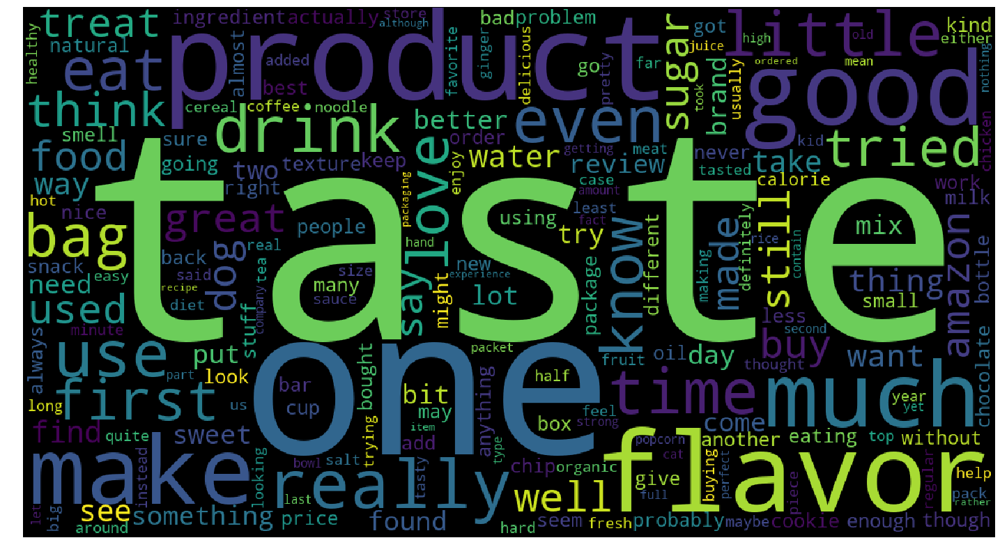

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by BOW Featurization :  0.07


In [88]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 3: " + str(BOW_length_C3))
print(" ")
print("Cluster 3 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C3)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by BOW Featurization : "
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 4: 505
 
Cluster 4 obtained by BOW Featurization:


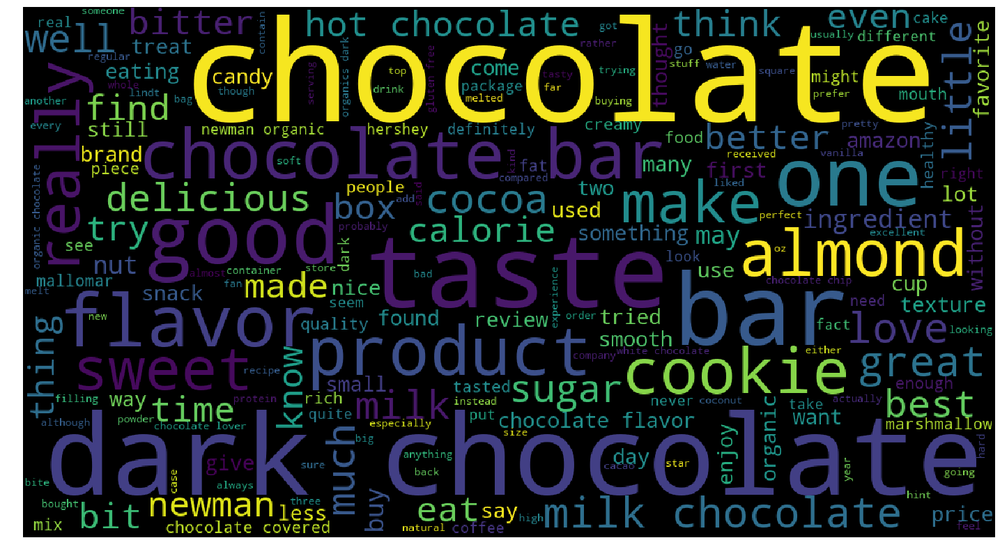

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by BOW Featurization :  0.04


In [89]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 4: " + str(BOW_length_C4))
print(" ")
print("Cluster 4 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C4)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by BOW Featurization : "
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 5: 1246
 
Cluster 5 obtained by BOW Featurization:


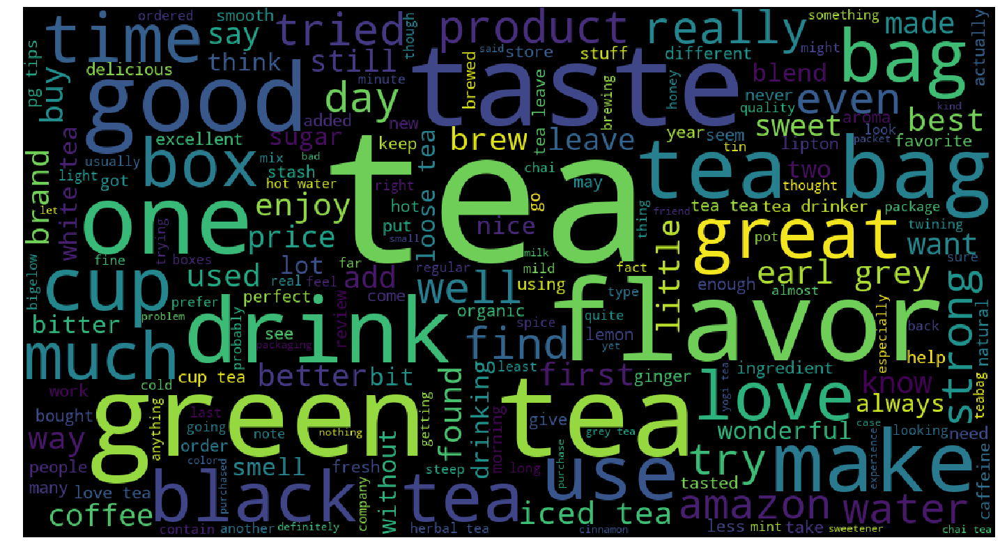

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by BOW Featurization :  0.04


In [90]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 5: " + str(BOW_length_C5))
print(" ")
print("Cluster 5 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by BOW Featurization : "
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 6: 930
 
Cluster 6 obtained by BOW Featurization:


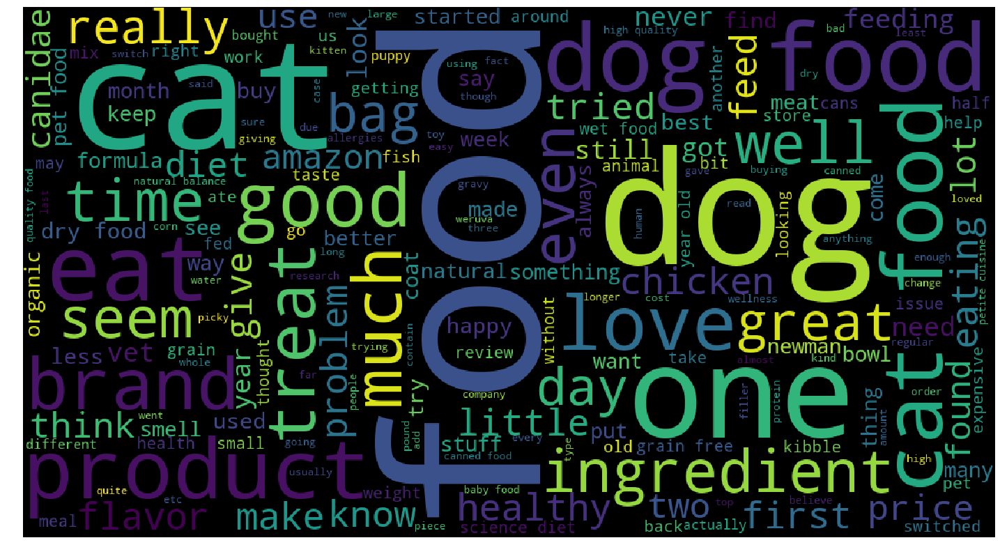

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by BOW Featurization :  0.05


In [91]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 6: " + str(BOW_length_C6))
print(" ")
print("Cluster 6 obtained by BOW Featurization:")

Show_Wordcloud(BOW_indices_C6)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by BOW Featurization : "
      , np.round((end - start)/60,2))

# [5.1.3] SET 2 : Applying K-Means Clustering on TFIDF :-

In [52]:
tf_idf_vect = TfidfVectorizer(ngram_range=(1,2), min_df=10)
TFIDF_K_vectorized = tf_idf_vect.fit_transform(K_Means_df['Preprocessed_Reviews']) 

#fit_transform internally considers the parameters that will be used for transforming the data from the text to a 
#numerical vector and then carries out the Transformation

In [53]:
TFIDF_K_vectorized.shape

(50000, 29907)

# Hyperparameter Tuning on the TFIDF Representation :- 

Again, here we take n_init ie the number of initializations to be equal to 10 ie the initialization will be carried out 10 times and max_iter=200. This means that the iterations keep occuring till the defined tolerance level is achieved ie. the distance between the final centroid and the semi-final centroid is > tolerance.

In [54]:
TFIDF_inertia = []

for k in tqdm(K_hyperparam):
    TFIDF_KMModel = KMeans(n_clusters=k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                      random_state=0,n_jobs=-1,algorithm='auto')
    # I have taken n_jobs=-1 so as to parallelise the entire execution. A specification of -1 in this scenario
    # means to use all the processors that are available.
    
    TFIDF_KMModel.fit(TFIDF_K_vectorized)
    TFIDF_squared_distance_sum = TFIDF_KMModel.inertia_
    TFIDF_inertia.append(TFIDF_squared_distance_sum)    

100%|██████████| 10/10 [3:47:09<00:00, 1505.97s/it] 


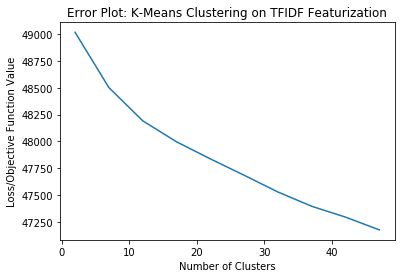

In [72]:
#Plotting the Values of Inertia (Objectve/Loss Function) for different values of K:-

plt.plot(K_hyperparam,TFIDF_inertia)

plt.xlabel('Number of Clusters')
plt.ylabel('Loss/Objective Function Value')
plt.title('Error Plot: K-Means Clustering on TFIDF Featurization')

plt.show()

Again, here you are obtaining the Best Value of K by plotting the Loss Function for K-Means vs the Number of Clusters. This best value is obtained by the Elbow Plot and finding the value of K where the first bend in the curve actually begins.

As we see here, K=7 is a good value to be taken for the n_clusters as a parameter in KMeans.

In [56]:
TFIDF_optimal_k=7

# [5.1.4] Wordclouds of Clusters obtained after applying K-Means on TFIDF :-

In [58]:
import time
start = time.time()

#Training the Model on the Optimal Value of K

TFIDF_KMeans_final = KMeans(n_clusters=TFIDF_optimal_k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                          random_state=0,n_jobs=-1,algorithm='auto')
TFIDF_KMeans_final.fit(TFIDF_K_vectorized)

end = time.time()
print("Time consumed (in minutes) in Training the model on the Optimal K using TFIDF Featurization : "
      , np.round((end - start)/60,2))

Time consumed (in minutes) in Training the model on the Optimal K using TFIDF Featurization :  24.23


<b> <font color="black"> Calling the Review_Cluster() Function on TFIDF Model:- </font> </b>

In [59]:
TFIDF_C0 = []
TFIDF_C1 = []
TFIDF_C2 = []
TFIDF_C3 = []
TFIDF_C4 = []
TFIDF_C5 = []
TFIDF_C6 = []

TFIDF_indices_C0,TFIDF_length_C0 = Review_Cluster(TFIDF_KMeans_final,0,TFIDF_C0)
TFIDF_indices_C1,TFIDF_length_C1 = Review_Cluster(TFIDF_KMeans_final,1,TFIDF_C1)
TFIDF_indices_C2,TFIDF_length_C2 = Review_Cluster(TFIDF_KMeans_final,2,TFIDF_C2)
TFIDF_indices_C3,TFIDF_length_C3 = Review_Cluster(TFIDF_KMeans_final,3,TFIDF_C3)
TFIDF_indices_C4,TFIDF_length_C4 = Review_Cluster(TFIDF_KMeans_final,4,TFIDF_C4)
TFIDF_indices_C5,TFIDF_length_C5 = Review_Cluster(TFIDF_KMeans_final,5,TFIDF_C5)
TFIDF_indices_C6,TFIDF_length_C6 = Review_Cluster(TFIDF_KMeans_final,6,TFIDF_C6)

<b> <font color="black"> Obtaining Word Clouds for the Individual Clusters for TFIDF Featurization :- </font> </b>

Again, here it is to be noted that the Cluster Labelling starts from 0 and hence the labels for the 7 clusters will be [0-6].

Number of Reviews Classified into Cluster 0: 2320
 
Cluster 0 obtained by TFIDF Featurization:


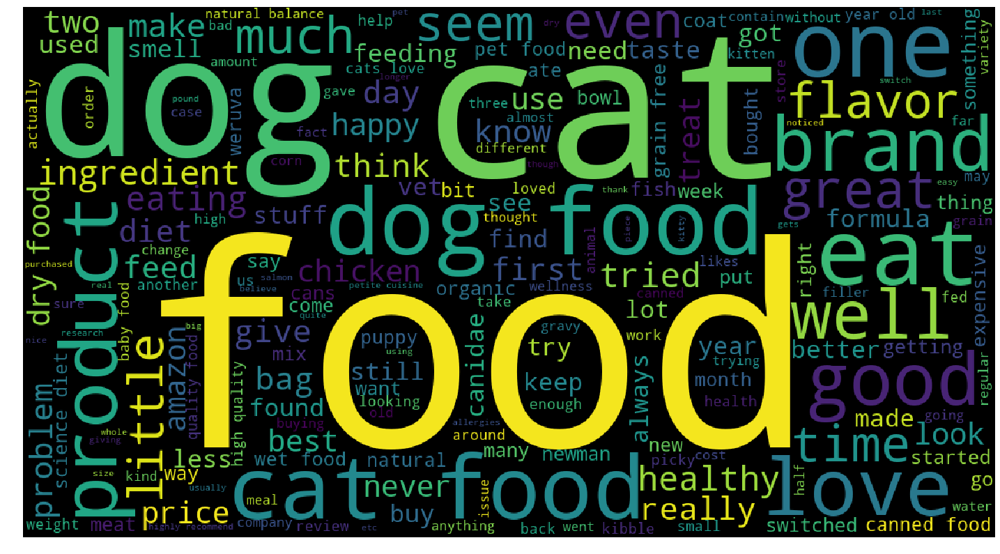

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF Featurization : 0.05


In [79]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(TFIDF_length_C0))
print(" ")
print("Cluster 0 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C0)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 3569
 
Cluster 1 obtained by TFIDF Featurization:


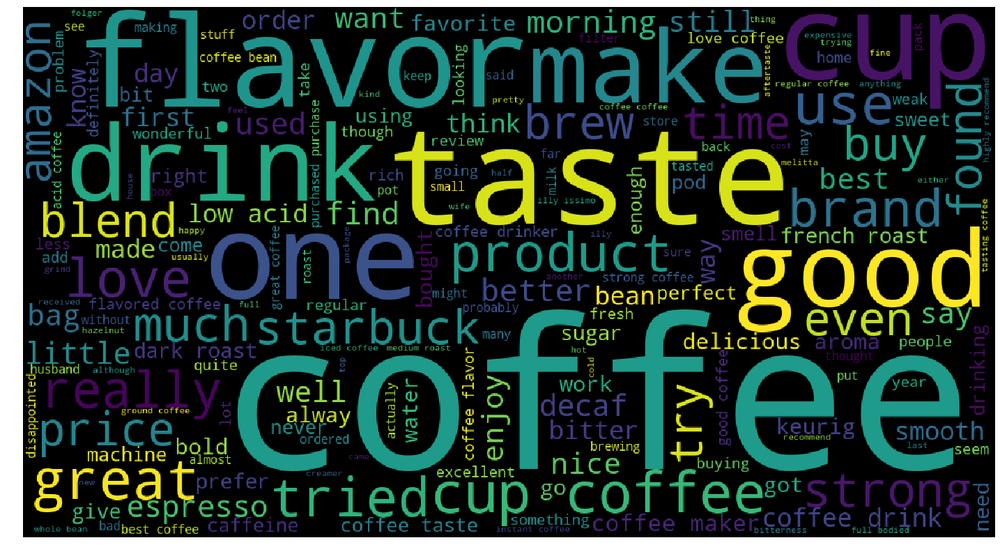

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF Featurization : 0.05


In [80]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(TFIDF_length_C1))
print(" ")
print("Cluster 1 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C1)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 2: 3590
 
Cluster 2 obtained by TFIDF Featurization:


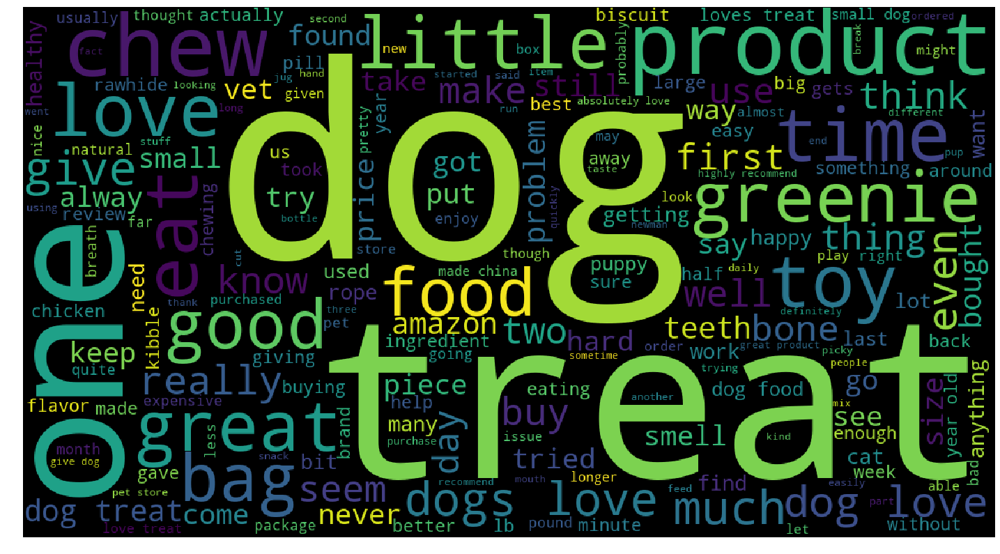

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by TFIDF Featurization : 0.05


In [81]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 2: " + str(TFIDF_length_C2))
print(" ")
print("Cluster 2 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 3: 1986
 
Cluster 3 obtained by TFIDF Featurization:


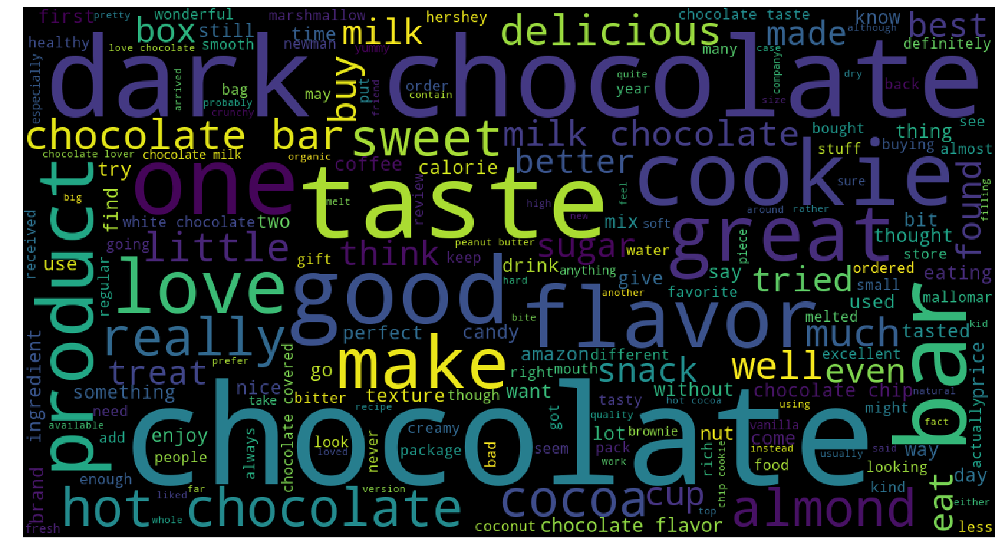

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by TFIDF Featurization : 0.05


In [82]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 3: " + str(TFIDF_length_C3))
print(" ")
print("Cluster 3 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C3)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 4: 14127
 
Cluster 4 obtained by TFIDF Featurization:


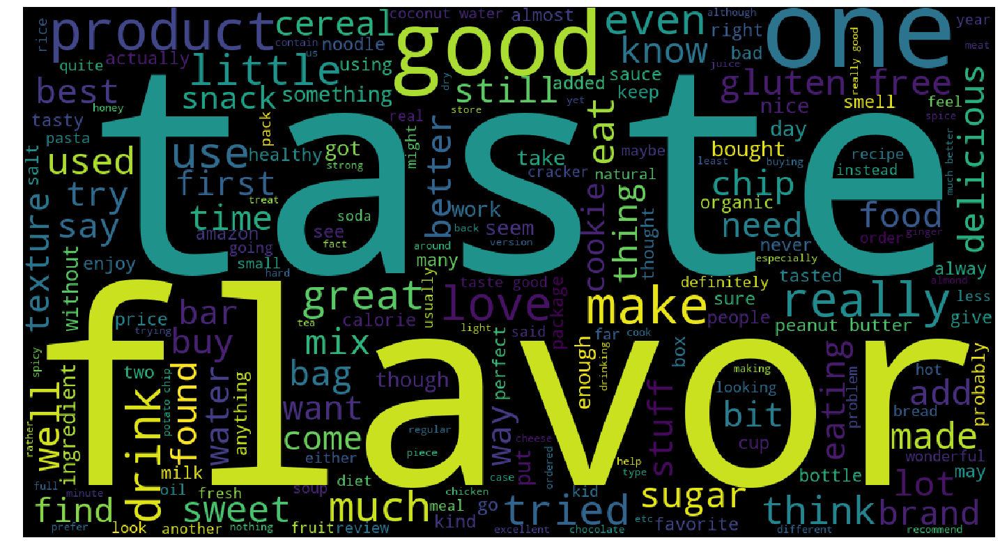

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by TFIDF Featurization : 0.11


In [83]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 4: " + str(TFIDF_length_C4))
print(" ")
print("Cluster 4 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C4)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 5: 20845
 
Cluster 5 obtained by TFIDF Featurization:


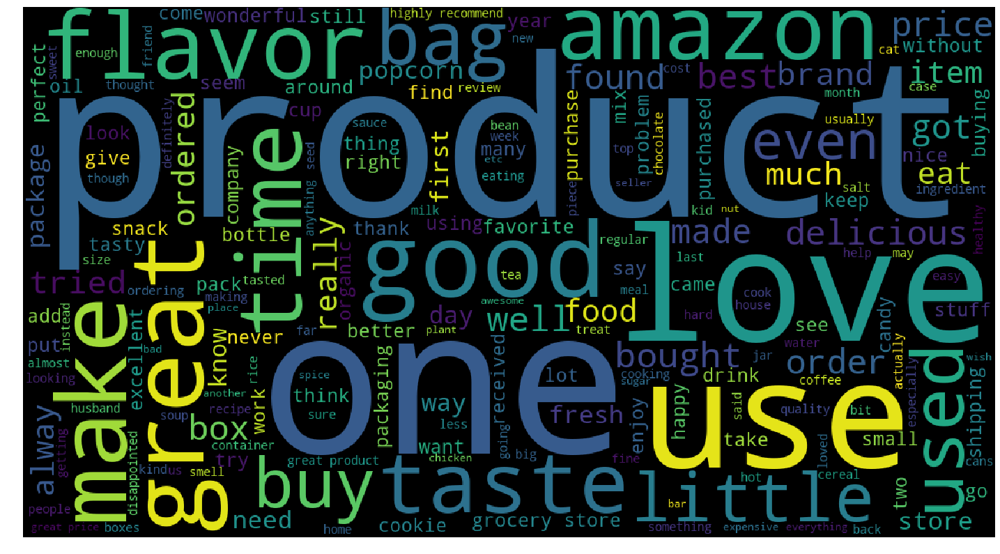

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by TFIDF Featurization : 0.12


In [78]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 5: " + str(TFIDF_length_C5))
print(" ")
print("Cluster 5 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 6: 3563
 
Cluster 6 obtained by TFIDF Featurization:


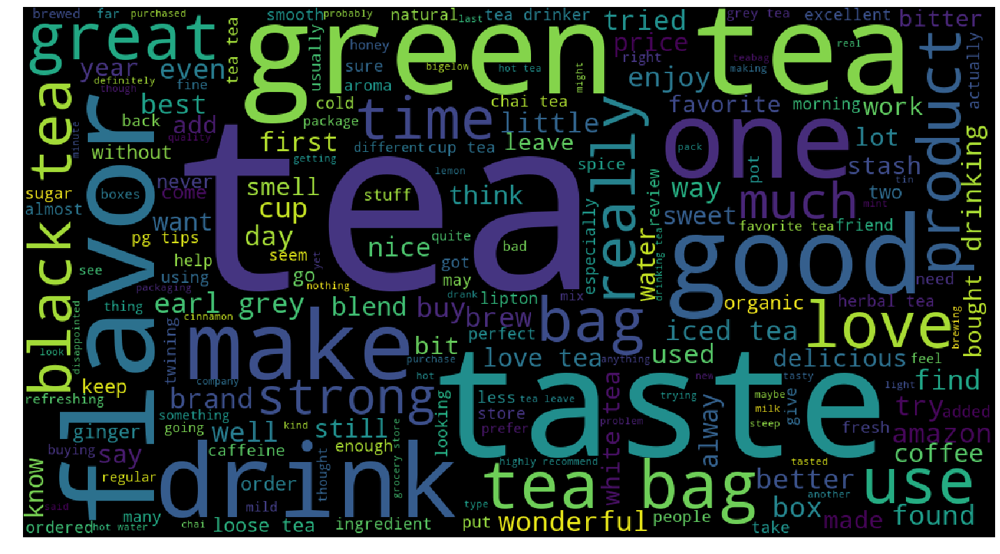

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by TFIDF Featurization : 0.05


In [84]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 6: " + str(TFIDF_length_C6))
print(" ")
print("Cluster 6 obtained by TFIDF Featurization:")

Show_Wordcloud(TFIDF_indices_C6)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by TFIDF Featurization :"
      , np.round((end - start)/60,2))

# [5.1.5] SET 3 : Applying K-Means Clustering on Avg W2V :-

# Converting Reviews into Numerical Vectors using W2V vectors :-

In [31]:
list_of_sentences =[]

for sentence in K_Means_df['Preprocessed_Reviews']:
    list_of_sentences.append(sentence.split())

In [32]:
w2v_model=Word2Vec(list_of_sentences,min_count=5,size=50, workers=4)

w2v_words = list(w2v_model.wv.vocab)

print("Number of words that occur a minimum 5 times :",len(w2v_words))
print("Some of the sample words are as follows: ", w2v_words[0:50])

Number of words that occur a minimum 5 times : 13431
Some of the sample words are as follows:  ['dogs', 'love', 'saw', 'pet', 'store', 'tag', 'attached', 'regarding', 'made', 'china', 'satisfied', 'safe', 'loves', 'chicken', 'product', 'wont', 'buying', 'anymore', 'hard', 'find', 'products', 'usa', 'one', 'isnt', 'bad', 'good', 'take', 'chances', 'till', 'know', 'going', 'imports', 'available', 'victor', 'traps', 'unreal', 'course', 'total', 'fly', 'pretty', 'stinky', 'right', 'nearby', 'used', 'bait', 'seasons', 'ca', 'not', 'beat', 'great']


# Converting the Text Data :-

Here, basically we are converting the 50K datapoints into a vector form that will be used across Training as well as Hyperparameter Tuning.  

In [33]:
# average Word2Vec
# compute average word2vec for each review.

sent_vectors = [];                    # the avg-w2v for each sentence/review is stored in this list
for sent in tqdm(list_of_sentences):
    sent_vec = np.zeros(50) 
    cnt_words =0;                     # num of words with a valid vector in the sentence/review
    for word in sent:                 # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)
sent_vectors = np.array(sent_vectors)
print(sent_vectors.shape)
print(sent_vectors[0])

100%|██████████| 50000/50000 [02:32<00:00, 327.43it/s]


(50000, 50)
[-0.47802416  0.28359532  1.16966793 -0.27560138  0.13382258 -0.03364347
  0.1928246   0.24692138  0.73526759 -0.32241358  0.61040737  0.31000591
 -0.71134939 -1.17085928 -0.2572511   0.23421874 -0.73193005 -1.12252094
 -1.06568892  0.38235963 -0.73102718  0.22378556  0.12226722  0.48317516
  0.1558646  -0.20688268 -0.56418162 -0.62596657 -0.17528751  0.01057821
  0.86758633  0.34099021  0.10787522  0.27989     0.27189555 -0.02268257
 -0.04202493  0.35246187  0.36740545  0.38982025 -0.97920149  0.08187564
  0.32312435  0.04250758  0.80437704  0.63073841 -0.0733017  -0.93256283
 -0.14064959  1.04487767]


# Hyperparameter Tuning on the Avg W2V Representation :- 

Again, here we take n_init ie the number of initializations to be equal to 10 ie the initialization will be carried out 10 times and max_iter=200. This means that the iterations keep occuring till the defined tolerance level is achieved ie. the distance between the final centroid and the semi-final centroid is > tolerance.

In [71]:
AW2V_inertia = []

for k in tqdm(K_hyperparam):
    AW2V_KMModel = KMeans(n_clusters=k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                      random_state=0,n_jobs=-1,algorithm='auto')
    # I have taken n_jobs=-1 so as to parallelise the entire execution. A specification of -1 in this scenario
    # means to use all the processors that are available.
    
    AW2V_KMModel.fit(sent_vectors)
    AW2V_squared_distance_sum = AW2V_KMModel.inertia_
    AW2V_inertia.append(AW2V_squared_distance_sum)    

100%|██████████| 10/10 [03:58<00:00, 35.12s/it]


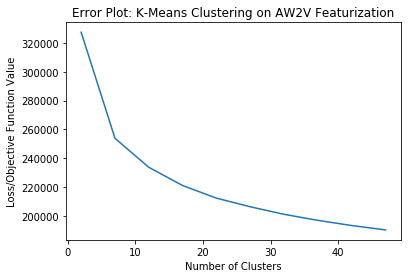

In [73]:
#Plotting the Values of Inertia (Objectve/Loss Function) for different values of K:-

plt.plot(K_hyperparam,AW2V_inertia)

plt.xlabel('Number of Clusters')
plt.ylabel('Loss/Objective Function Value')
plt.title('Error Plot: K-Means Clustering on AW2V Featurization')

plt.show()

Again, here you are obtaining the Best Value of K by plotting the Loss Function for K-Means vs the Number of Clusters. This best value is obtained by the Elbow Plot and finding the value of K where the first bend in the curve actually begins.

As we see here, K=7 is a good value to be taken for the n_clusters as a parameter in KMeans.

In [74]:
AW2V_optimal_k=7

# [5.1.6] Wordclouds of Clusters obtained after applying K-Means on Avg W2V :-

In [75]:
import time
start = time.time()

#Training the Avg W2V Model on the Optimal Value of K

AW2V_KMeans_final = KMeans(n_clusters=AW2V_optimal_k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                          random_state=0,n_jobs=-1,algorithm='auto')
AW2V_KMeans_final.fit(sent_vectors)

end = time.time()
print("Time consumed (in minutes) in Training the model on the Optimal K using Avg W2V Featurization : "
      , np.round((end - start)/60,2))

Time consumed (in minutes) in Training the model on the Optimal K using Avg W2V Featurization :  0.09


<b> <font color="black"> Calling the Review_Cluster() Function on Avg W2V Model:- </font> </b>

In [76]:
AW2V_C0 = []
AW2V_C1 = []
AW2V_C2 = []
AW2V_C3 = []
AW2V_C4 = []
AW2V_C5 = []
AW2V_C6 = []

AW2V_indices_C0,AW2V_length_C0 = Review_Cluster(AW2V_KMeans_final,0,AW2V_C0)
AW2V_indices_C1,AW2V_length_C1 = Review_Cluster(AW2V_KMeans_final,1,AW2V_C1)
AW2V_indices_C2,AW2V_length_C2 = Review_Cluster(AW2V_KMeans_final,2,AW2V_C2)
AW2V_indices_C3,AW2V_length_C3 = Review_Cluster(AW2V_KMeans_final,3,AW2V_C3)
AW2V_indices_C4,AW2V_length_C4 = Review_Cluster(AW2V_KMeans_final,4,AW2V_C4)
AW2V_indices_C5,AW2V_length_C5 = Review_Cluster(AW2V_KMeans_final,5,AW2V_C5)
AW2V_indices_C6,AW2V_length_C6 = Review_Cluster(AW2V_KMeans_final,6,AW2V_C6)

<b> <font color="black"> Obtaining Word Clouds for the Individual Clusters for Avg W2V Featurization :- </font> </b>

Cluster Labelling starts from 0 and hence the labels for the 7 clusters will be [0-6].

Number of Reviews Classified into Cluster 0: 6406
 
Cluster 0 obtained by AW2V Featurization:


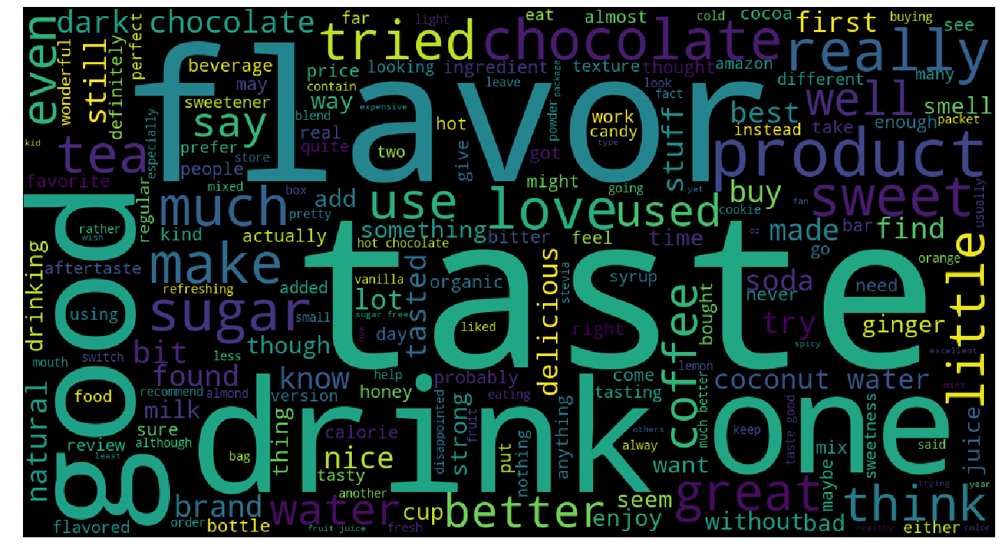

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by AW2V Featurization : 0.06


In [93]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(AW2V_length_C0))
print(" ")
print("Cluster 0 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C0)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 11032
 
Cluster 1 obtained by AW2V Featurization:


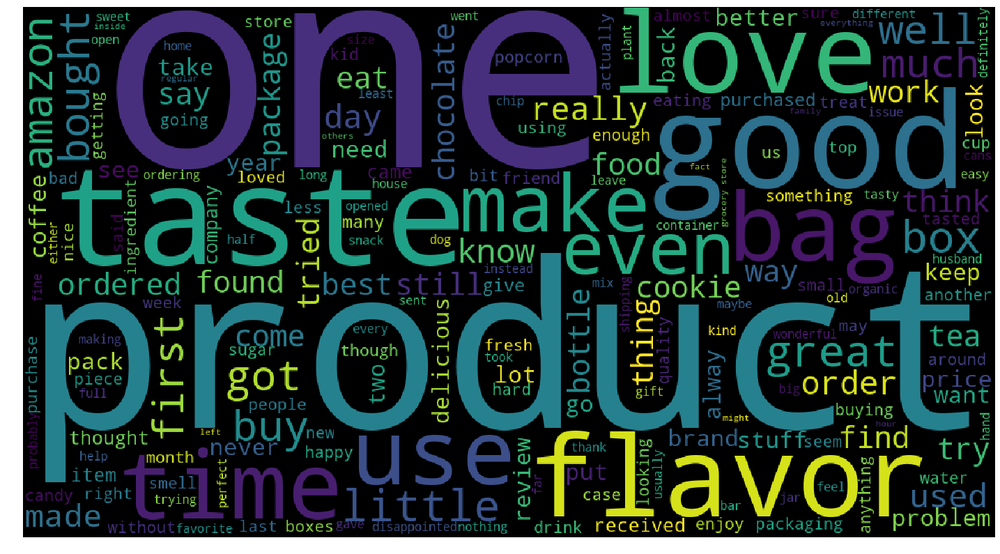

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by AW2V Featurization : 0.09


In [94]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(AW2V_length_C1))
print(" ")
print("Cluster 1 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C1)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 2: 5836
 
Cluster 2 obtained by AW2V Featurization:


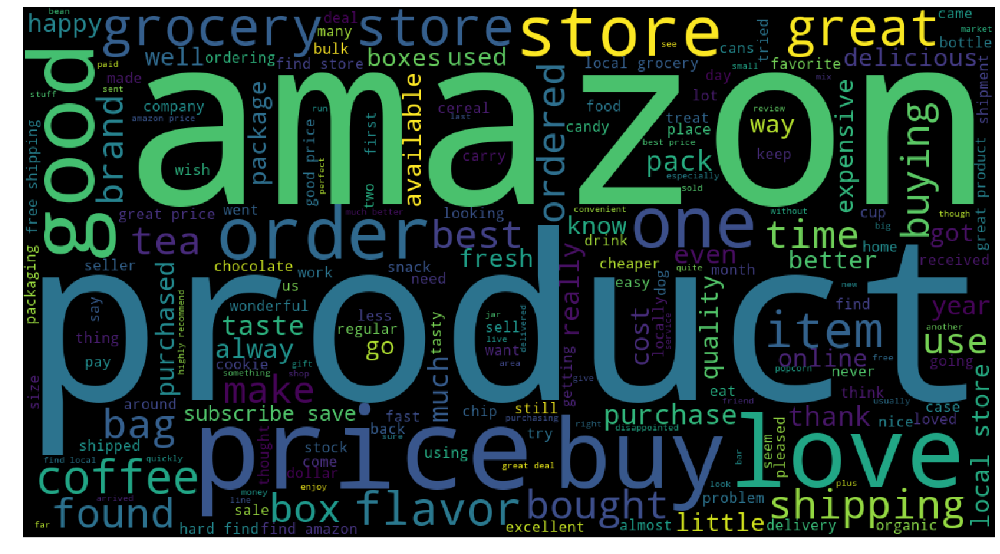

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by AW2V Featurization : 0.05


In [95]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 2: " + str(AW2V_length_C2))
print(" ")
print("Cluster 2 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 3: 6584
 
Cluster 3 obtained by AW2V Featurization:


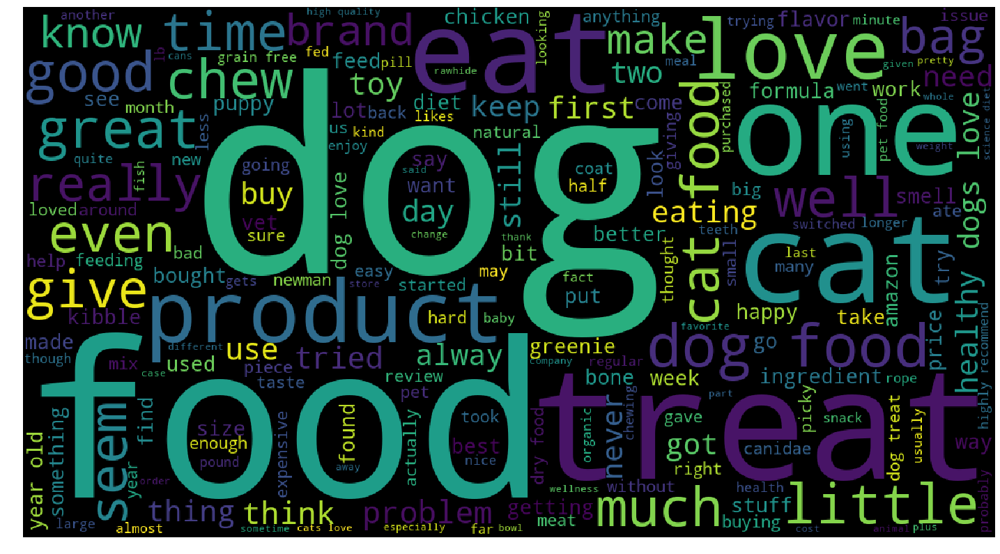

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by AW2V Featurization : 0.07


In [96]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 3: " + str(AW2V_length_C3))
print(" ")
print("Cluster 3 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C3)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 4: 7170
 
Cluster 4 obtained by AW2V Featurization:


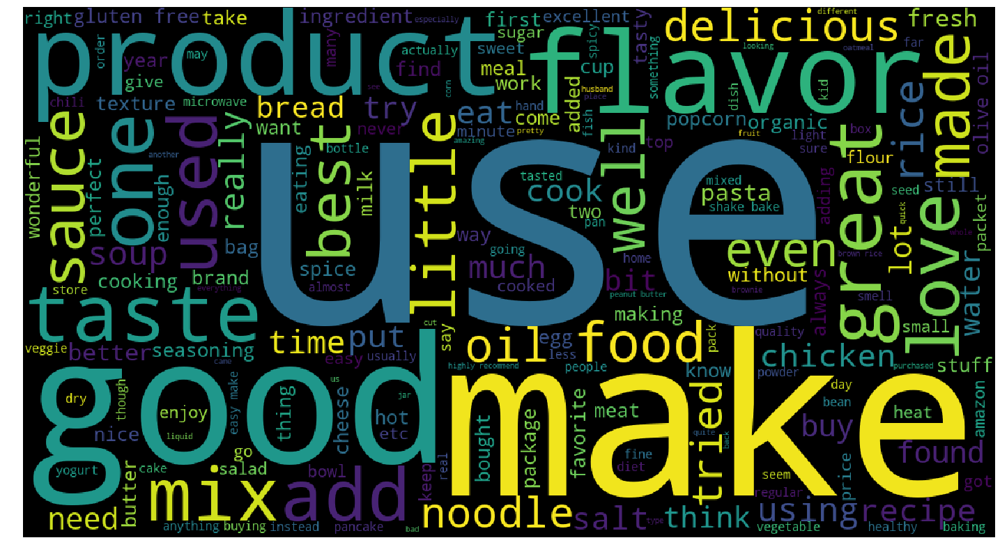

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by AW2V Featurization : 0.08


In [97]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 4: " + str(AW2V_length_C4))
print(" ")
print("Cluster 4 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C4)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 5: 6612
 
Cluster 5 obtained by AW2V Featurization:


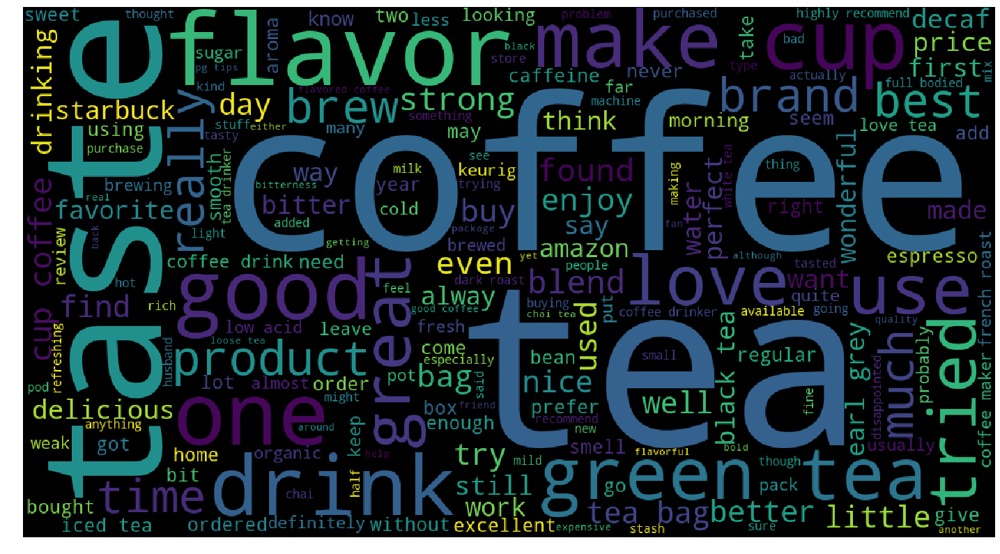

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by AW2V Featurization : 0.06


In [98]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 5: " + str(AW2V_length_C5))
print(" ")
print("Cluster 5 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 6: 6360
 
Cluster 6 obtained by AW2V Featurization:


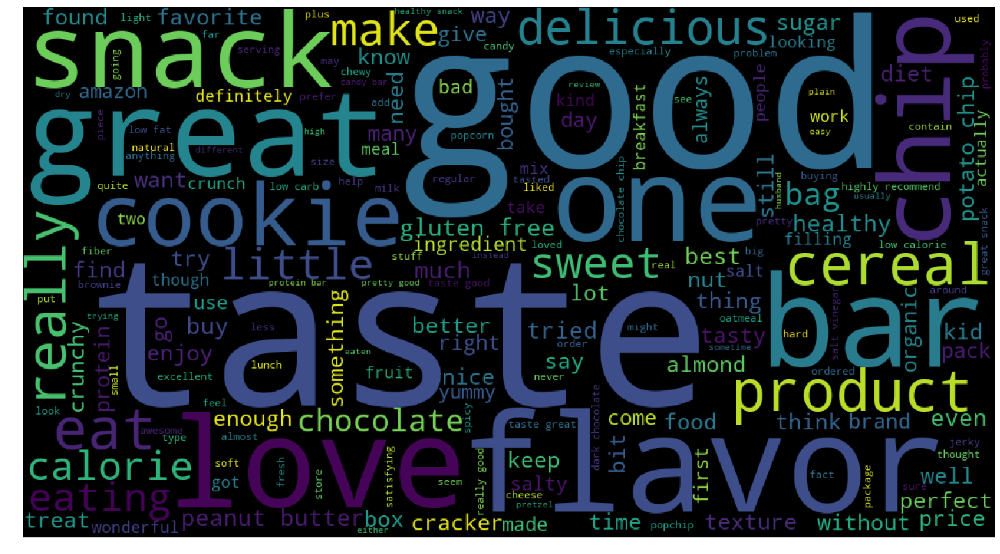

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by AW2V Featurization : 0.06


In [99]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 6: " + str(AW2V_length_C6))
print(" ")
print("Cluster 6 obtained by AW2V Featurization:")

Show_Wordcloud(AW2V_indices_C6)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by AW2V Featurization :"
      , np.round((end - start)/60,2))

# [5.1.7] SET 4 : Applying K-Means Clustering on TFIDF W2V :-

In [61]:
model_KMeans = TfidfVectorizer()
tf_idf_matrix = model_KMeans.fit_transform(K_Means_df['Preprocessed_Reviews'])

# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(model_KMeans.get_feature_names(), list(model_KMeans.idf_)))

In [62]:
tf_idf_matrix.shape

(50000, 41655)

# Converting Reviews into Numerical Vectors using W2V vectors :-

# Converting the Text Data :-

In [63]:
# TF-IDF weighted Word2Vec
tfidf_feat = model_KMeans.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors = []; # the tfidf-w2v for each sentence/review from Training Data is stored in this list
row=0;
for sent in tqdm(list_of_sentences): # for each review/sentence in Training Data
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words and word in tfidf_feat:
            vec = w2v_model.wv[word]
            #tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

100%|██████████| 50000/50000 [26:23<00:00, 31.58it/s]  


# Hyperparameter Tuning on the TFIDF W2V Representation :- 

Again, here we take n_init ie the number of initializations to be equal to 10 ie the initialization will be carried out 10 times and max_iter=200. This means that the iterations keep occuring till the defined tolerance level is achieved ie. the distance between the final centroid and the semi-final centroid is > tolerance.

In [103]:
TFIDFW2V_inertia = []

for k in tqdm(K_hyperparam):
    TFIDFW2V_KMModel = KMeans(n_clusters=k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                      random_state=0,n_jobs=-1,algorithm='auto')
    # I have taken n_jobs=-1 so as to parallelise the entire execution. A specification of -1 in this scenario
    # means to use all the processors that are available.
    
    TFIDFW2V_KMModel.fit(tfidf_sent_vectors)
    TFIDFW2V_squared_distance_sum = TFIDFW2V_KMModel.inertia_
    TFIDFW2V_inertia.append(TFIDFW2V_squared_distance_sum)    

100%|██████████| 10/10 [04:12<00:00, 37.59s/it]


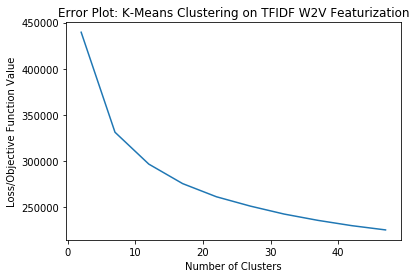

In [104]:
#Plotting the Values of Inertia (Objectve/Loss Function) for different values of K:-

plt.plot(K_hyperparam,TFIDFW2V_inertia)

plt.xlabel('Number of Clusters')
plt.ylabel('Loss/Objective Function Value')
plt.title('Error Plot: K-Means Clustering on TFIDF W2V Featurization')

plt.show()

Again, here you are obtaining the Best Value of K by plotting the Loss Function for K-Means vs the Number of Clusters. This best value is obtained by the Elbow Plot and finding the value of K where the first bend in the curve actually begins.

As we see here, K=7 is a good value to be taken for the n_clusters as a parameter in KMeans.

In [105]:
TFIDFW2V_optimal_k=7

# [5.1.8] Wordclouds of Clusters obtained after applying K-Means on TFIDF W2V :- 

In [106]:
import time
start = time.time()

#Training the TFIDF W2V Model on the optimal value of K

TFIDFW2V_KMeans_final = KMeans(n_clusters=TFIDFW2V_optimal_k,init='k-means++',n_init=10,max_iter=200,tol=0.0001,
                          random_state=0,n_jobs=-1,algorithm='auto')
TFIDFW2V_KMeans_final.fit(tfidf_sent_vectors)

end = time.time()
print("Time consumed (in minutes) in Training the model on the Optimal K using TFIDF W2V Featurization : "
      , np.round((end - start)/60,2))

Time consumed (in minutes) in Training the model on the Optimal K using TFIDF W2V Featurization :  0.1


<b> <font color="black"> Calling the Review_Cluster() Function on TFIDF W2V Model:- </font> </b>

In [107]:
TFIDFW2V_C0 = []
TFIDFW2V_C1 = []
TFIDFW2V_C2 = []
TFIDFW2V_C3 = []
TFIDFW2V_C4 = []
TFIDFW2V_C5 = []
TFIDFW2V_C6 = []

TFIDFW2V_indices_C0,TFIDFW2V_length_C0 = Review_Cluster(TFIDFW2V_KMeans_final,0,TFIDFW2V_C0)
TFIDFW2V_indices_C1,TFIDFW2V_length_C1 = Review_Cluster(TFIDFW2V_KMeans_final,1,TFIDFW2V_C1)
TFIDFW2V_indices_C2,TFIDFW2V_length_C2 = Review_Cluster(TFIDFW2V_KMeans_final,2,TFIDFW2V_C2)
TFIDFW2V_indices_C3,TFIDFW2V_length_C3 = Review_Cluster(TFIDFW2V_KMeans_final,3,TFIDFW2V_C3)
TFIDFW2V_indices_C4,TFIDFW2V_length_C4 = Review_Cluster(TFIDFW2V_KMeans_final,4,TFIDFW2V_C4)
TFIDFW2V_indices_C5,TFIDFW2V_length_C5 = Review_Cluster(TFIDFW2V_KMeans_final,5,TFIDFW2V_C5)
TFIDFW2V_indices_C6,TFIDFW2V_length_C6 = Review_Cluster(TFIDFW2V_KMeans_final,6,TFIDFW2V_C6)

<b> <font color="black"> Obtaining Word Clouds for the Individual Clusters for TFIDF W2V Featurization :- </font> </b>

The Cluster Labelling starts from 0 and hence the labels for the 7 clusters will be [0-6].

Number of Reviews Classified into Cluster 0: 6498
 
Cluster 0 obtained by TFIDF W2V Featurization:


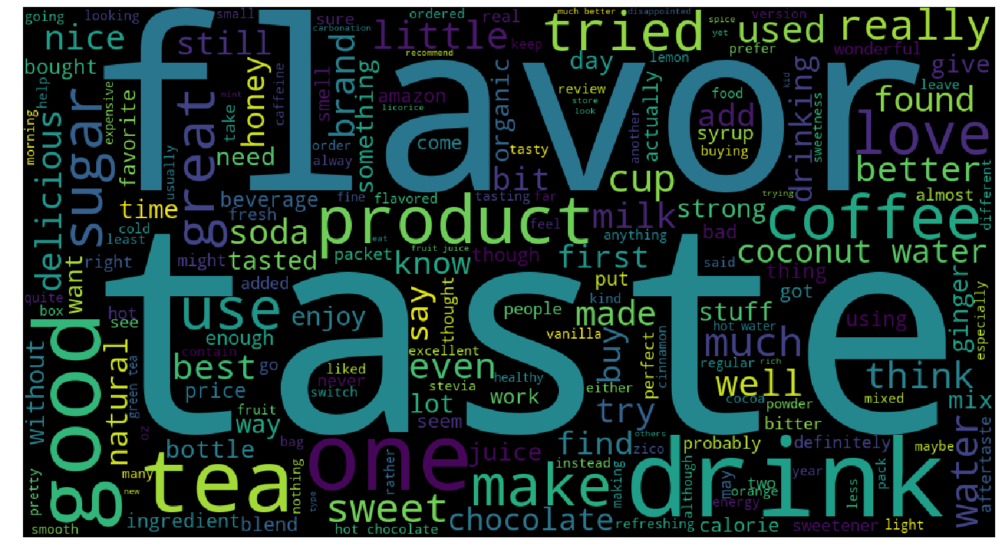

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization : 0.06


In [108]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(TFIDFW2V_length_C0))
print(" ")
print("Cluster 0 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C0)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 13026
 
Cluster 1 obtained by TFIDF W2V Featurization:


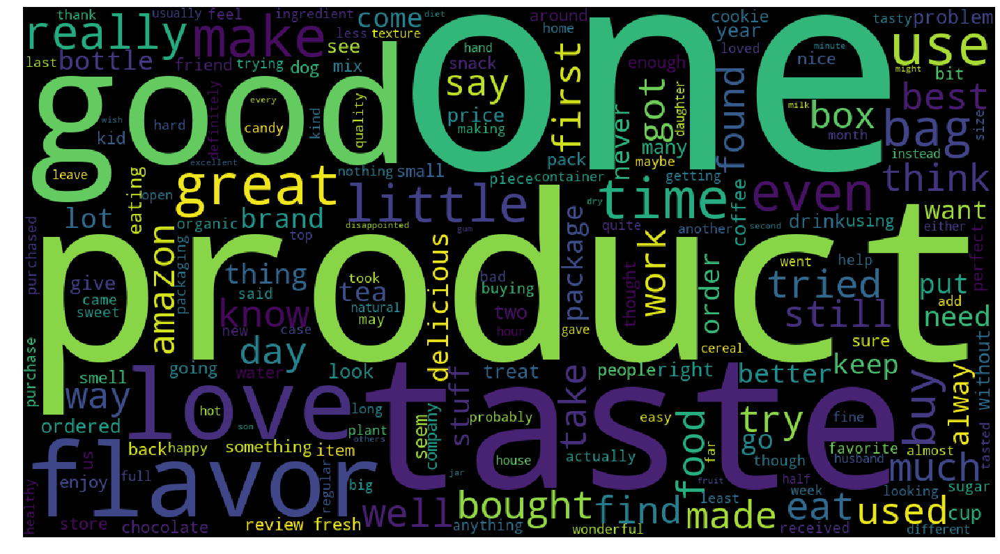

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization : 0.1


In [109]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(TFIDFW2V_length_C1))
print(" ")
print("Cluster 1 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C1)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 2: 6142
 
Cluster 2 obtained by TFIDF W2V Featurization:


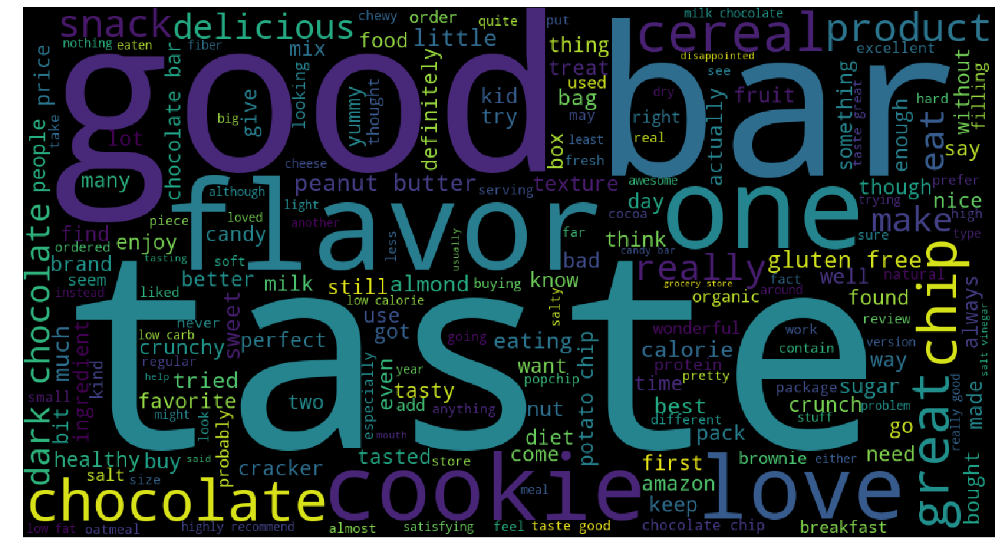

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by TFIDF W2V Featurization : 0.06


In [110]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 2: " + str(TFIDFW2V_length_C2))
print(" ")
print("Cluster 2 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 3: 4821
 
Cluster 3 obtained by TFIDF W2V Featurization:


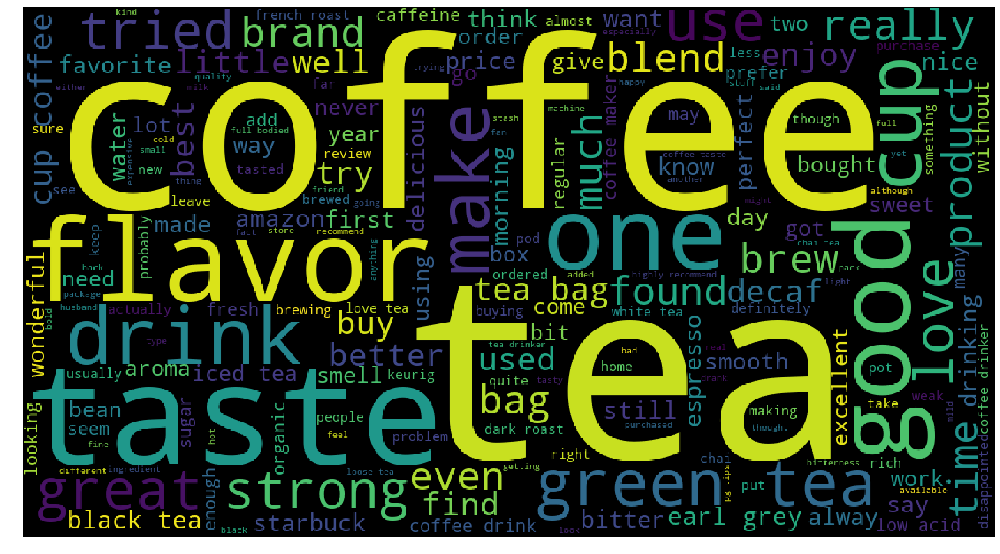

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by TFIDF W2V Featurization : 0.06


In [111]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 3: " + str(TFIDFW2V_length_C3))
print(" ")
print("Cluster 3 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C3)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 4: 6740
 
Cluster 4 obtained by TFIDF W2V Featurization:


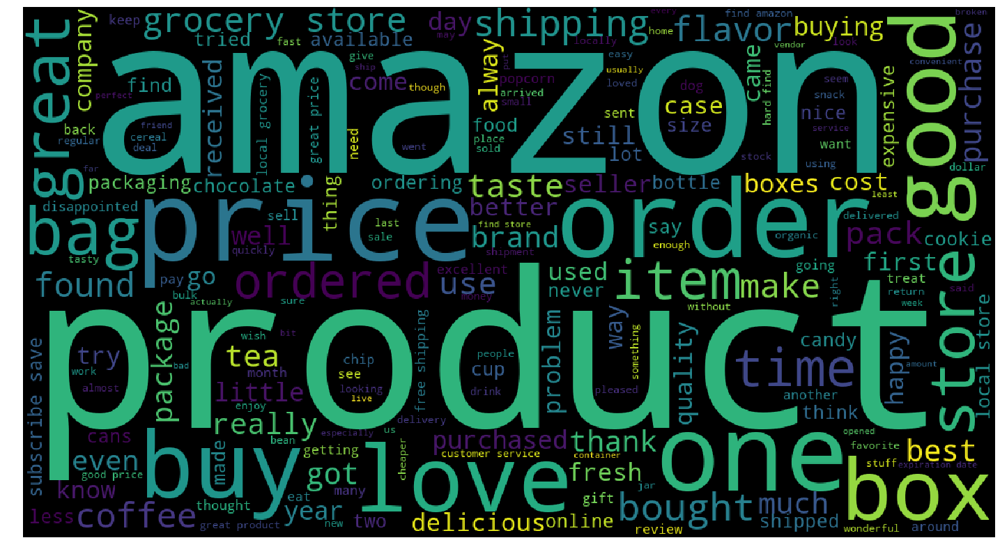

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by TFIDF W2V Featurization : 0.06


In [113]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 4: " + str(TFIDFW2V_length_C4))
print(" ")
print("Cluster 4 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C4)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 5: 6004
 
Cluster 5 obtained by TFIDF W2V Featurization:


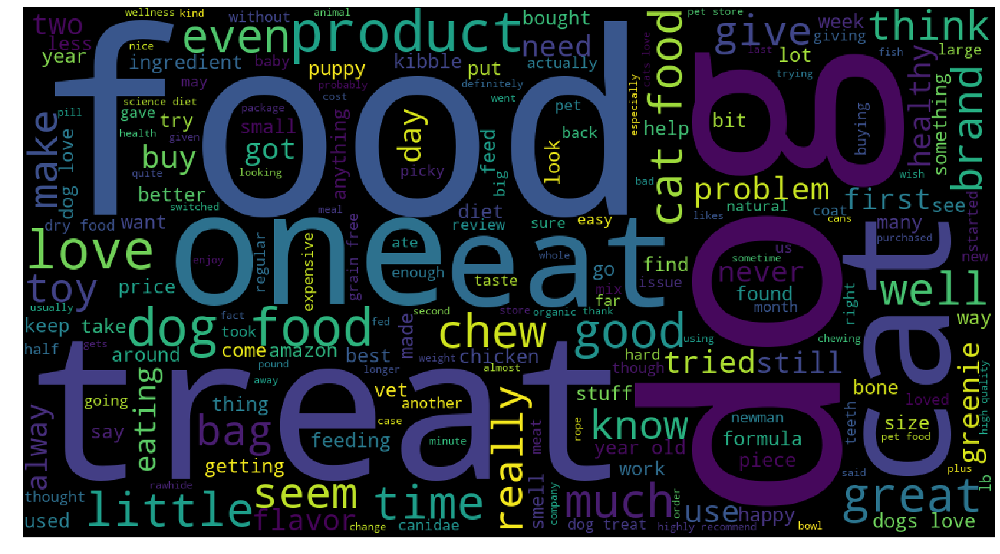

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by TFIDF W2V Featurization : 0.06


In [112]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 5: " + str(TFIDFW2V_length_C5))
print(" ")
print("Cluster 5 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 5 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 6: 6769
 
Cluster 6 obtained by TFIDF W2V Featurization:


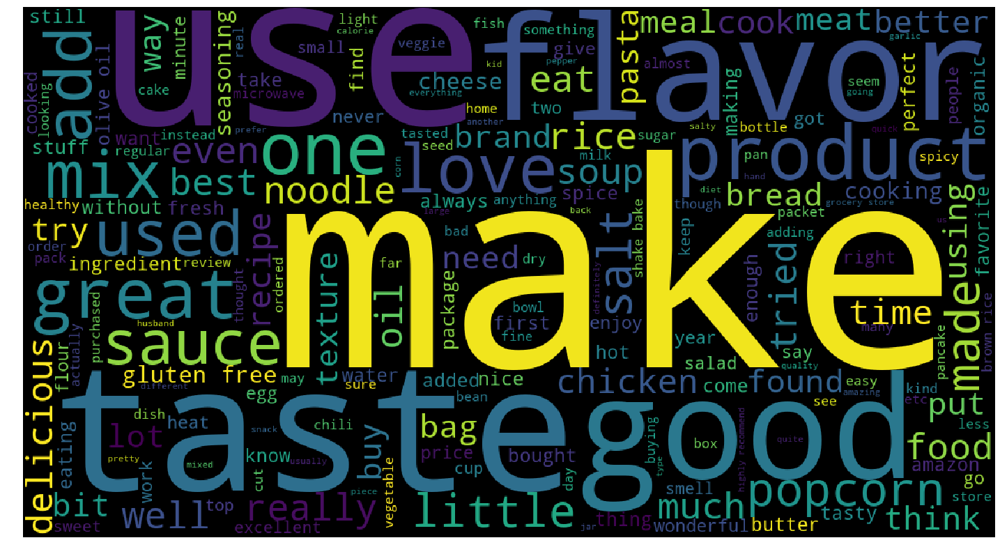

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by TFIDF W2V Featurization : 0.07


In [114]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 6: " + str(TFIDFW2V_length_C6))
print(" ")
print("Cluster 6 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C6)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 6 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

# [5.2] Applying Agglomerative Clustering :-

# [5.2.1] Applying Agglomerative Clustering on AVG W2V :-

In [116]:
#Importing AgglomerativeClustering

from sklearn.cluster import AgglomerativeClustering

Here, one of the Major Disadvantages of the Hierarchical Clustering Techniques of Agglomerative & Divisive Clustering is the fact that there is no mathematical objective function for the same, and hence we cannot carry out Hyperparameter Tuning on any Objective Function. 

Therefore we basically build 2 Models :- one with the Number of Clusters = 2, and other with the Number of Clusters = 5. This is carried out below: 

In [118]:
#Setting the number of clusters = 2

import time
start = time.time()

AW2V_Agg_Model_2 = AgglomerativeClustering(n_clusters=2,linkage='ward')
AW2V_Agg_Model_2.fit(sent_vectors)    

end = time.time()
print("Time Required to Run this Code Snippet (in minutes) : "
      ,(end - start)/60)

Time Required to Run this Code Snippet (in minutes) :  260.23574246962863


In [122]:
#Setting the number of clusters = 5

import time
start = time.time()

AW2V_Agg_Model_5 = AgglomerativeClustering(n_clusters=5,linkage='ward')
AW2V_Agg_Model_5.fit(sent_vectors)    

end = time.time()
print("Time Required to Run this Code Snippet (in minutes) : "
      , np.round((end - start)/60,2))

Time Required to Run this Code Snippet (in minutes) :  282.77


<b> <font color="black"> Calling the Review_Cluster() Function on Avg W2V Model for Agglomerative Clustering:- </font> </b>

In [119]:
#For Model 1

AW2V_C0_Agg2 = []
AW2V_C1_Agg2 = []

AW2V_indices_C0_Agg2,AW2V_length_C0_Agg2 = Review_Cluster(AW2V_Agg_Model_2,0,AW2V_C0_Agg2)
AW2V_indices_C1_Agg2,AW2V_length_C1_Agg2 = Review_Cluster(AW2V_Agg_Model_2,1,AW2V_C1_Agg2)

In [123]:
#For Model 2

AW2V_C0_Agg5 = []
AW2V_C1_Agg5 = []
AW2V_C2_Agg5 = []
AW2V_C3_Agg5 = []
AW2V_C4_Agg5 = []

AW2V_indices_C0_Agg5,AW2V_length_C0_Agg5 = Review_Cluster(AW2V_Agg_Model_5,0,AW2V_C0_Agg5)
AW2V_indices_C1_Agg5,AW2V_length_C1_Agg5 = Review_Cluster(AW2V_Agg_Model_5,1,AW2V_C1_Agg5)
AW2V_indices_C2_Agg5,AW2V_length_C2_Agg5 = Review_Cluster(AW2V_Agg_Model_5,2,AW2V_C2_Agg5)
AW2V_indices_C3_Agg5,AW2V_length_C3_Agg5 = Review_Cluster(AW2V_Agg_Model_5,3,AW2V_C3_Agg5)
AW2V_indices_C4_Agg5,AW2V_length_C4_Agg5 = Review_Cluster(AW2V_Agg_Model_5,4,AW2V_C4_Agg5)

# [5.2.2] Wordclouds of Clusters obtained after applying Agglomerative Clustering on AVG W2V :-

<b> <font color="black"> Obtaining the WordClouds on Avg W2V for Agglomerative Clustering when Number of Clusters = 2 :- </font> </b>

Again, here it is to be noted that the Cluster Labelling starts from 0 and hence the labels for the 2 clusters will be "0" & "1".

Number of Reviews Classified into Cluster 0: 33098
 
Cluster 0 obtained by Avg W2V Featurization:


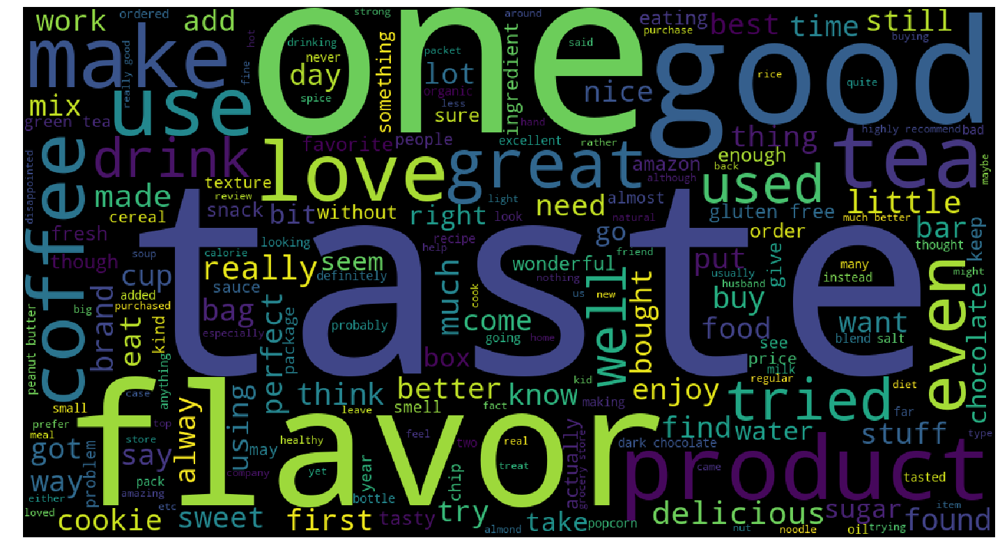

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by Avg W2V Featurization : 0.18


In [120]:
#Obtaining Cluster 0 When Number of Clusters =2 

import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(AW2V_length_C0_Agg2))
print(" ")
print("Cluster 0 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C0_Agg2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 16902
 
Cluster 1 obtained by Avg W2V Featurization:


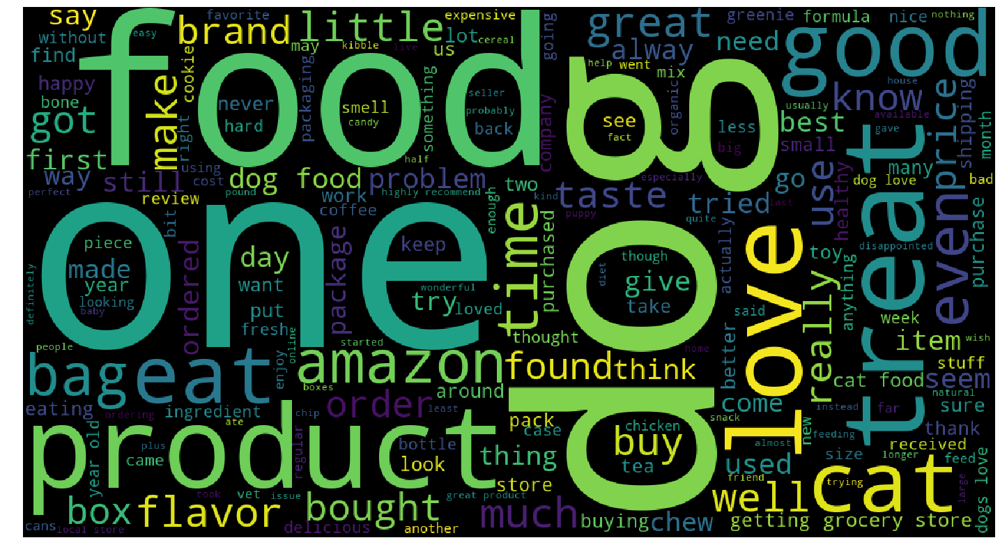

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by Avg W2V Featurization : 0.11


In [121]:
#Obtaining Cluster 1 When Number of Clusters =2 

import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(AW2V_length_C1_Agg2))
print(" ")
print("Cluster 1 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C1_Agg2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

<b> <font color="black"> Obtaining the WordClouds on Avg W2V for Agglomerative Clustering when Number of Clusters = 5 :- </font> </b>

Again, here it is to be noted that the Cluster Labelling starts from 0 and hence the labels for the 5 clusters will be [0-4].

Number of Reviews Classified into Cluster 0: 13411
 
Cluster 0 obtained by Avg W2V Featurization:


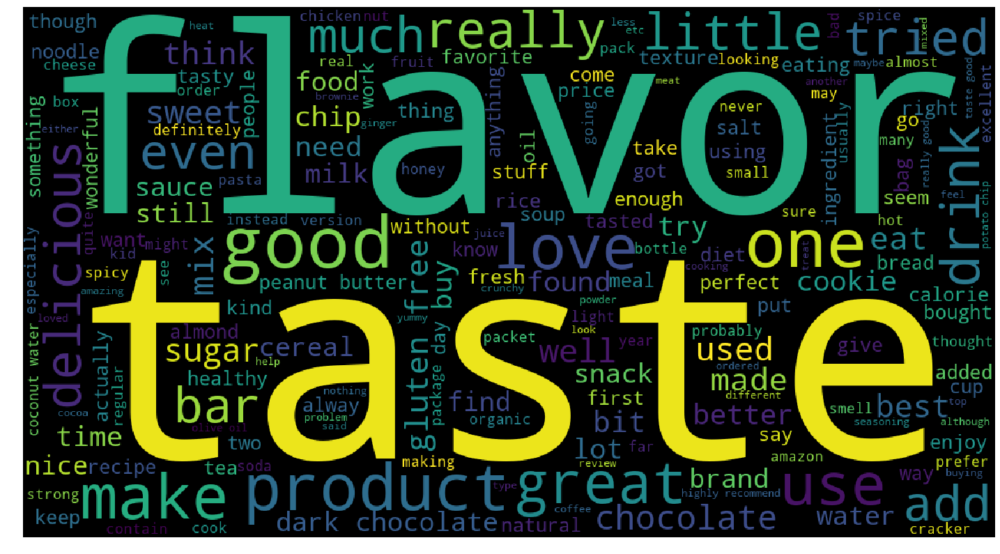

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by Avg W2V Featurization : 0.1


In [124]:
#Obtaining Cluster 0 When Number of Clusters =5  [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(AW2V_length_C0_Agg5))
print(" ")
print("Cluster 0 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C0_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 9457
 
Cluster 1 obtained by Avg W2V Featurization:


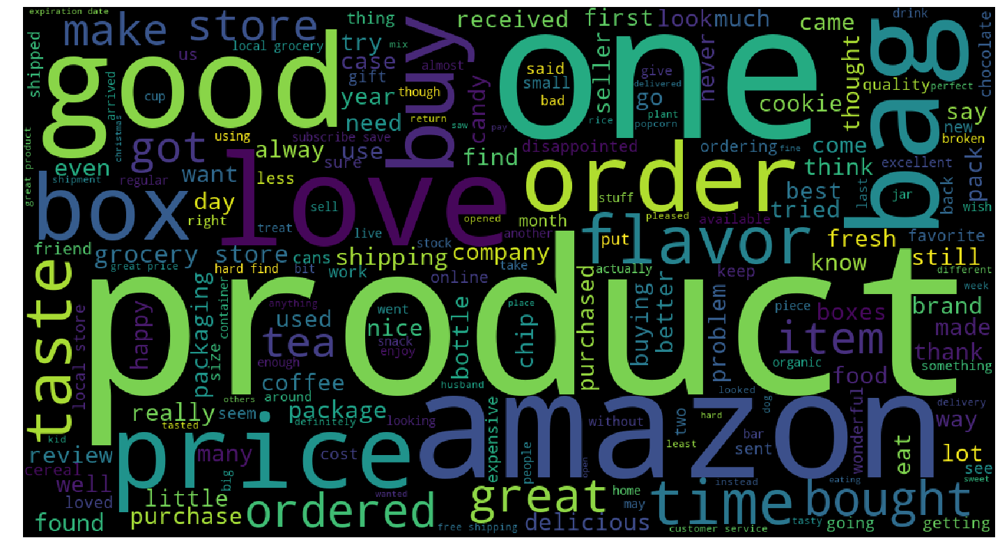

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by Avg W2V Featurization : 0.07


In [125]:
#Obtaining Cluster 1 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(AW2V_length_C1_Agg5))
print(" ")
print("Cluster 1 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C1_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 2: 7121
 
Cluster 2 obtained by Avg W2V Featurization:


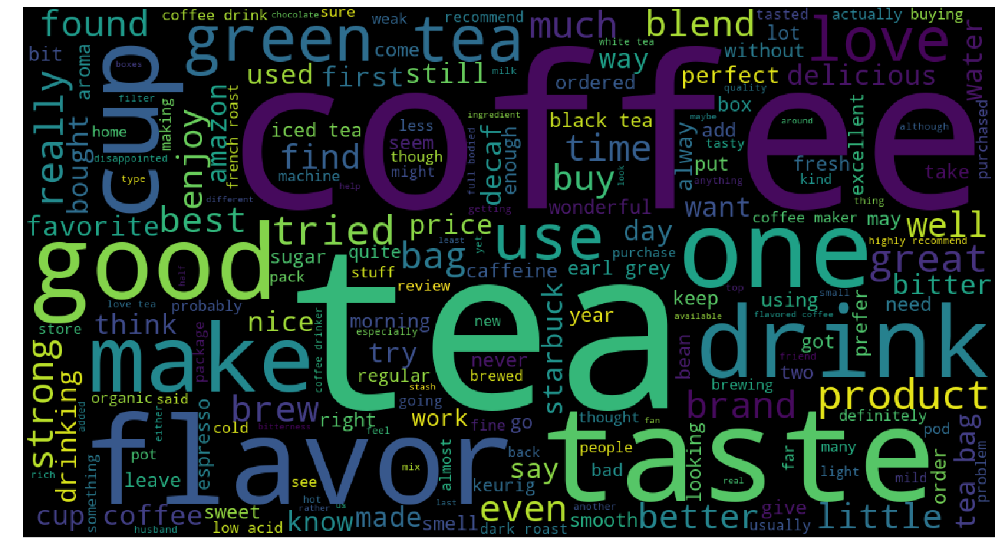

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by Avg W2V Featurization : 0.06


In [126]:
#Obtaining Cluster 2 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 2: " + str(AW2V_length_C2_Agg5))
print(" ")
print("Cluster 2 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C2_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 3: 7445
 
Cluster 3 obtained by Avg W2V Featurization:


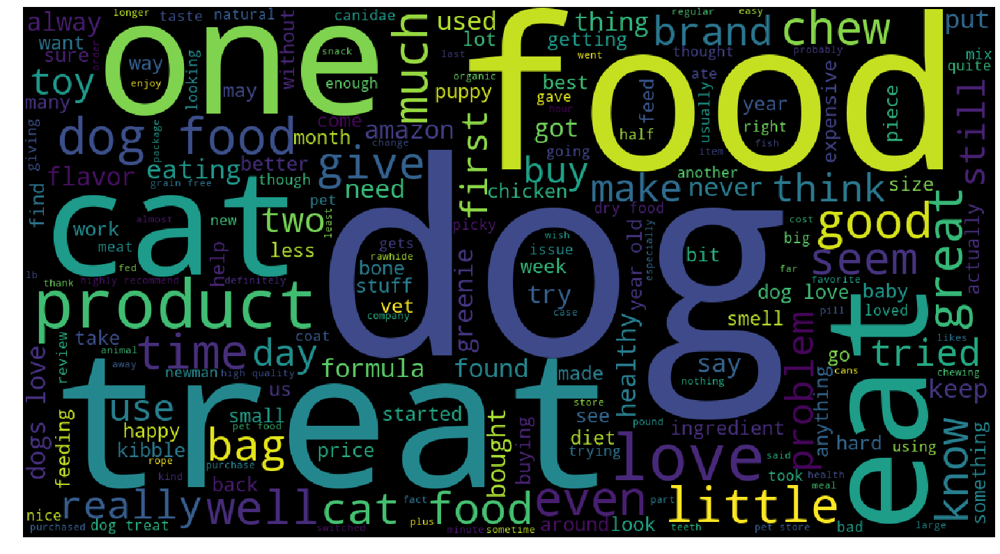

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by Avg W2V Featurization : 0.07


In [127]:
#Obtaining Cluster 3 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 3: " + str(AW2V_length_C3_Agg5))
print(" ")
print("Cluster 3 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C3_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 4: 12566
 
Cluster 4 obtained by Avg W2V Featurization:


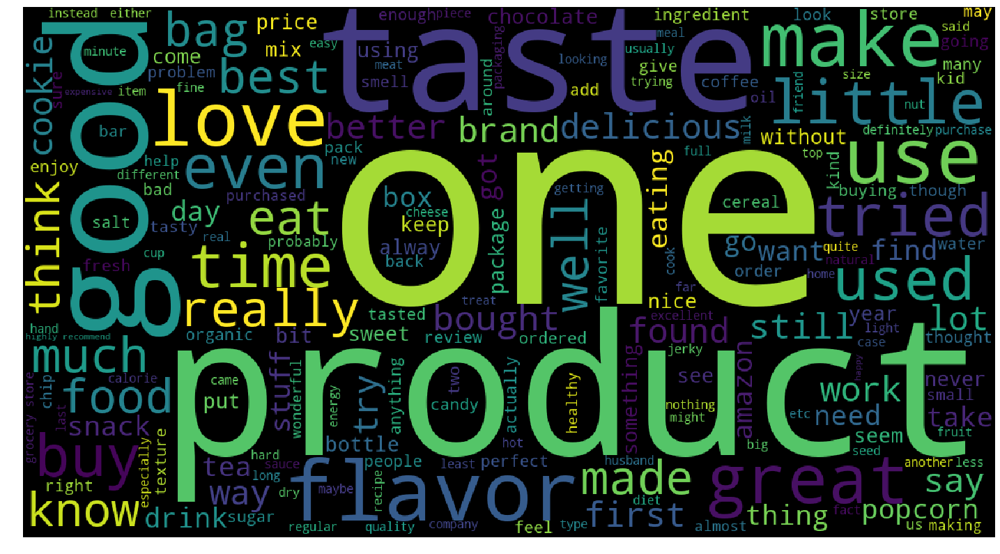

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by Avg W2V Featurization : 0.1


In [128]:
#Obtaining Cluster 4 When Number of Clusters =5  [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 4: " + str(AW2V_length_C4_Agg5))
print(" ")
print("Cluster 4 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C4_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by Avg W2V Featurization :"
      , np.round((end - start)/60,2))

# [5.2.3] Applying Agglomerative Clustering on TFIDF W2V :-

Again we build 2 Models :- one with the Number of Clusters = 2, and other with the Number of Clusters = 5. This is carried out below: 

In [129]:
#Setting the number of clusters = 2

import time
start = time.time()

TFIDFW2V_Agg_Model_2 = AgglomerativeClustering(n_clusters=2,linkage='ward')
TFIDFW2V_Agg_Model_2.fit(tfidf_sent_vectors)    

end = time.time()
print("Time Required to Run this Code Snippet (in minutes) : "
      , np.round((end - start)/60,2))

Time Required to Run this Code Snippet (in minutes) :  259.81


In [130]:
#Setting the number of clusters = 5

import time
start = time.time()

TFIDFW2V_Agg_Model_5 = AgglomerativeClustering(n_clusters=5,linkage='ward')
TFIDFW2V_Agg_Model_5.fit(tfidf_sent_vectors)    

end = time.time()
print("Time Required to Run this Code Snippet (in minutes) : "
      , np.round((end - start)/60,2))

Time Required to Run this Code Snippet (in minutes) :  281.41


<b> <font color="black"> Calling the Review_Cluster() Function on TFIDF W2V Model for Agglomerative Clustering:- </font> </b>

In [131]:
#For Model 1

TFIDFW2V_C0_Agg2 = []
TFIDFW2V_C1_Agg2 = []

TFIDFW2V_indices_C0_Agg2,TFIDFW2V_length_C0_Agg2 = Review_Cluster(TFIDFW2V_Agg_Model_2,0,TFIDFW2V_C0_Agg2)
TFIDFW2V_indices_C1_Agg2,TFIDFW2V_length_C1_Agg2 = Review_Cluster(TFIDFW2V_Agg_Model_2,1,TFIDFW2V_C1_Agg2)

In [132]:
#For Model 2

TFIDFW2V_C0_Agg5 = []
TFIDFW2V_C1_Agg5 = []
TFIDFW2V_C2_Agg5 = []
TFIDFW2V_C3_Agg5 = []
TFIDFW2V_C4_Agg5 = []

TFIDFW2V_indices_C0_Agg5,TFIDFW2V_length_C0_Agg5 = Review_Cluster(TFIDFW2V_Agg_Model_5,0,TFIDFW2V_C0_Agg5)
TFIDFW2V_indices_C1_Agg5,TFIDFW2V_length_C1_Agg5 = Review_Cluster(TFIDFW2V_Agg_Model_5,1,TFIDFW2V_C1_Agg5)
TFIDFW2V_indices_C2_Agg5,TFIDFW2V_length_C2_Agg5 = Review_Cluster(TFIDFW2V_Agg_Model_5,2,TFIDFW2V_C2_Agg5)
TFIDFW2V_indices_C3_Agg5,TFIDFW2V_length_C3_Agg5 = Review_Cluster(TFIDFW2V_Agg_Model_5,3,TFIDFW2V_C3_Agg5)
TFIDFW2V_indices_C4_Agg5,TFIDFW2V_length_C4_Agg5 = Review_Cluster(TFIDFW2V_Agg_Model_5,4,TFIDFW2V_C4_Agg5)

# [5.2.4] Wordclouds of Clusters obtained after applying Agglomerative Clustering on TFIDF W2V :-

<b> <font color="black"> Obtaining the WordClouds on TFIDF W2V for Agglomerative Clustering when Number of Clusters = 2 :- </font> </b>

{ Cluster Labelling starts from 0 and hence the labels for the 2 clusters will be "0" and "1" }

Number of Reviews Classified into Cluster 0: 40730
 
Cluster 0 obtained by TFIDF W2V Featurization:


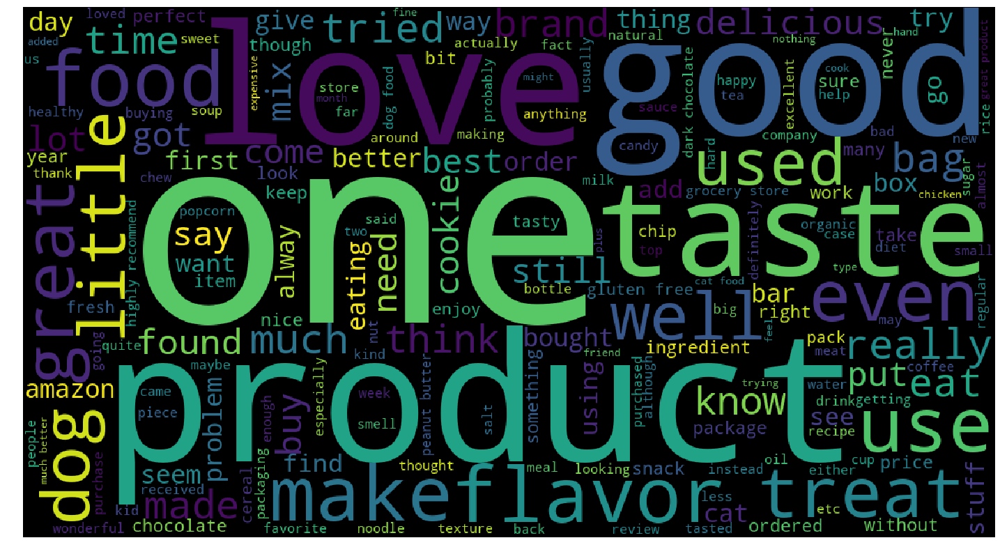

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization : 0.2


In [134]:
#Obtaining Cluster 0 When Number of Clusters =2 

import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(TFIDFW2V_length_C0_Agg2))
print(" ")
print("Cluster 0 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C0_Agg2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 9270
 
Cluster 1 obtained by TFIDF W2V Featurization:


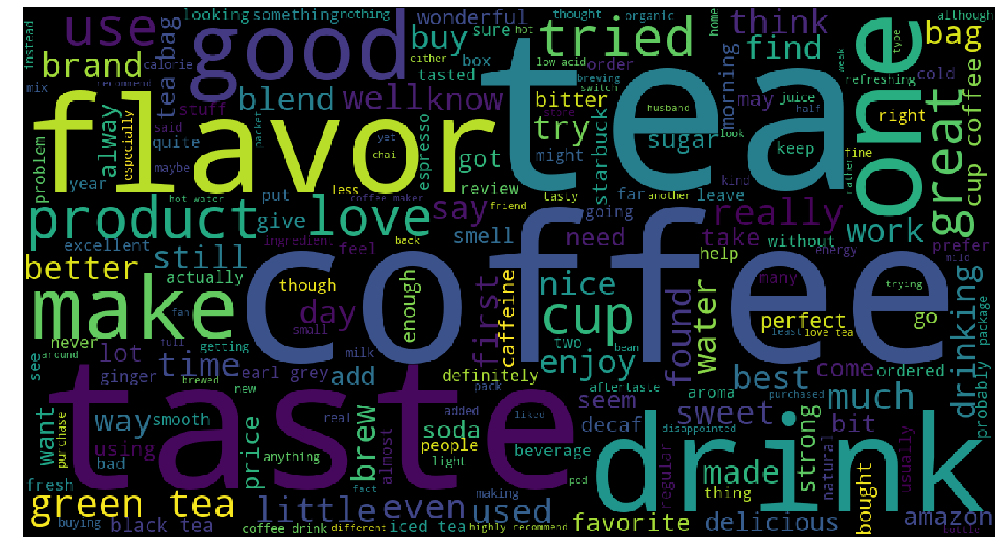

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization : 0.09


In [133]:
#Obtaining Cluster 1 When Number of Clusters =2 

import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(TFIDFW2V_length_C1_Agg2))
print(" ")
print("Cluster 1 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C1_Agg2)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

<b> <font color="black"> Obtaining the WordClouds on TFIDF W2V for Agglomerative Clustering when Number of Clusters = 5 :- </font> </b>

Note :- Cluster Labelling starts from 0 and hence the labels for the 5 clusters will be [0-4].

Number of Reviews Classified into Cluster 0: 16662
 
Cluster 0 obtained by TFIDF W2V Featurization:


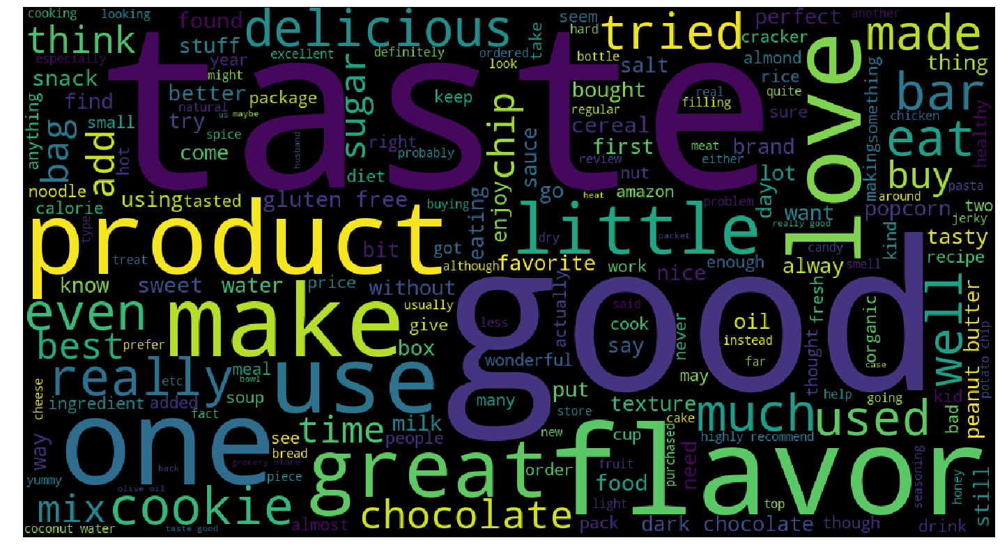

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization : 0.11


In [135]:
#Obtaining Cluster 0 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(TFIDFW2V_length_C0_Agg5))
print(" ")
print("Cluster 0 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C0_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 4528
 
Cluster 1 obtained by TFIDF W2V Featurization:


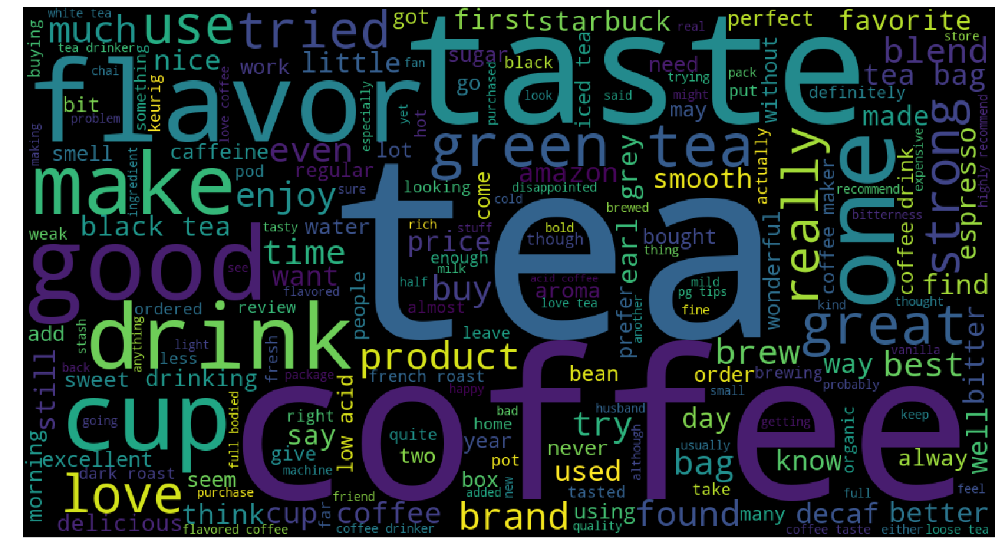

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization : 0.06


In [136]:
#Obtaining Cluster 1 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(TFIDFW2V_length_C1_Agg5))
print(" ")
print("Cluster 1 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C1_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 2: 6740
 
Cluster 2 obtained by TFIDF W2V Featurization:


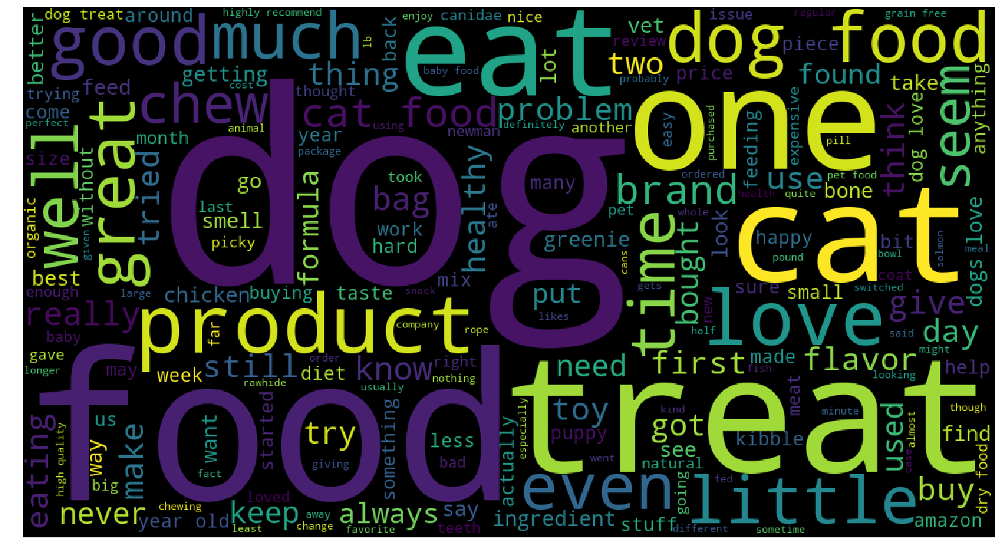

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by TFIDF W2V Featurization : 0.07


In [137]:
#Obtaining Cluster 2 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 2: " + str(TFIDFW2V_length_C2_Agg5))
print(" ")
print("Cluster 2 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C2_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 2 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 3: 17328
 
Cluster 3 obtained by TFIDF W2V Featurization:


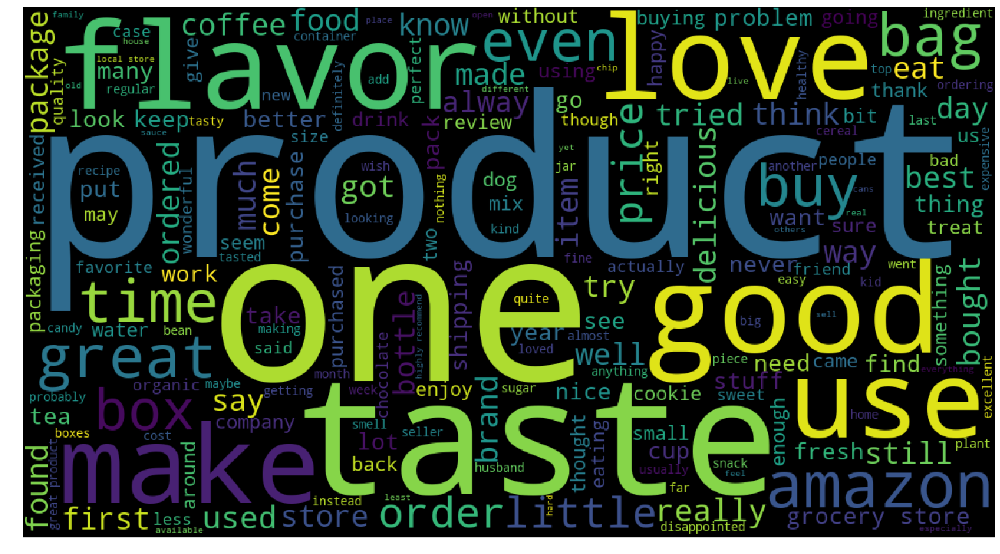

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by TFIDF W2V Featurization : 0.1


In [138]:
#Obtaining Cluster 3 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 3: " + str(TFIDFW2V_length_C3_Agg5))
print(" ")
print("Cluster 3 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C3_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 3 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 4: 4742
 
Cluster 4 obtained by TFIDF W2V Featurization:


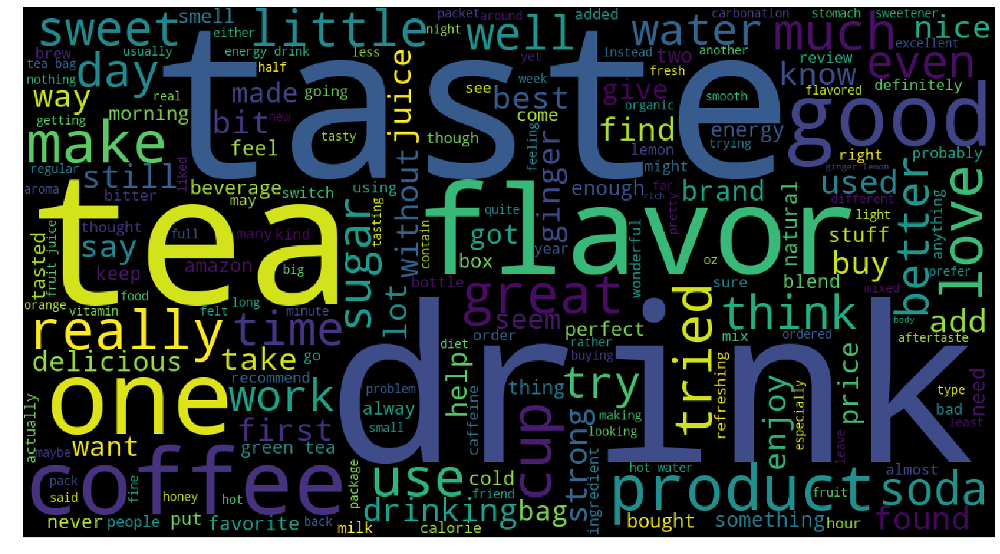

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by TFIDF W2V Featurization : 0.06


In [139]:
#Obtaining Cluster 4 When Number of Clusters =5 [0-4]

import time
start = time.time()

print("Number of Reviews Classified into Cluster 4: " + str(TFIDFW2V_length_C4_Agg5))
print(" ")
print("Cluster 4 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C4_Agg5)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 4 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

# [5.3] Applying DBSCAN Clustering :-

# [5.3.1] Applying DBSCAN Clustering on Avg W2V :-

# Hyperparameter Tuning on the Avg W2V Representation :- 

In [34]:
#Importing the Required Packages

from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors

Basically, this is what is done here :
* You call the "NearestNeighbors()" which is attached to the KNN Implementation. This basically returns the "n" nearest neighbour indices for a particular point as well as the corresponding distances. After defining the same it is fit() to our Featurization. 
* Now you can consider MinPts as the Parameter in DBSCAN as ideally equal to: 2 * dimensionality. Here, since the dimensionality for Avg W2V is 50, we can consider MinPts = 100.
* Therefore we only need to consider the 100th nearest Point for each of our features. This is computed for each of our datapoints.

* After this is carried out, we sort the distances obtained and plot them against the Indices, again to obtain another elbow plot. The distance where the curve starts increasing rapidly becomes our value of epsilon (eps).

<b> <font color="black"> Function to obtain the nth Smallest Distance input the MinPts:- </font> </b>

In [75]:
def nth_smallest_distance(featurization,minpts,pt_range):
    
    distance_list =[]
    index_list = []

    neigh = NearestNeighbors(n_neighbors=minpts)
    neigh.fit(featurization)
    
    for i in range(pt_range):
        distance,feature_index = neigh.kneighbors([featurization[i]])
        distance_list.append(distance[0][minpts-1])
        index_list.append(feature_index[0][minpts-1])
    return index_list,distance_list

<b> <font color="black"> Function to obtain the Sorted Distances input the nth smallest Distance:- </font> </b>

In [76]:
def sorted_distances(distances,featurization,pt_range):
    
    sorted_indices =[]
    sorted_dist = np.sort(distances)
    
    for i in range(pt_range):
        sorted_indices.append(i)
    return sorted_indices,sorted_dist

<b> <font color="black"> Calling the "nth_smallest_distance" & "sorted_distances" Functions :- </font> </b>

In [77]:
AW2V_indices,AW2V_distances = nth_smallest_distance(sent_vectors,100,sent_vectors.shape[1])
AW2V_sorted_indices,AW2V_sorted_distances = sorted_distances(AW2V_distances,sent_vectors,sent_vectors.shape[1])

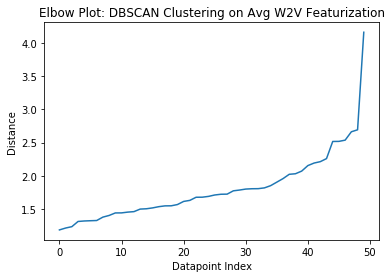

In [78]:
#Plotting Distance vs Data point index for Avg W2V

plt.plot(AW2V_sorted_indices,AW2V_sorted_distances)

plt.xlabel('Datapoint Index')
plt.ylabel('Distance')
plt.title('Elbow Plot: DBSCAN Clustering on Avg W2V Featurization')

plt.show()

In the plot above, the spike occurs around distance = 2.6, which becomes our value of eps.

In [39]:
optimal_eps_AW2V = 2.6

# Training DBSCAN Algorithm on the Avg W2V Representation :- 

In [40]:
import time
start = time.time()

AW2V_DBSCAN_Model = DBSCAN(eps=optimal_eps_AW2V,min_samples=100)
AW2V_DBSCAN_Model.fit(sent_vectors)    

end = time.time()
print("Time Required to Run this Code Snippet (in minutes) : "
      , np.round((end - start)/60,2))

Time Required to Run this Code Snippet (in minutes) :  9.6


In [85]:
set(AW2V_DBSCAN_Model.labels_)

{-1, 0}

Now we obtain the distinct labels after Density Based Clustering Training has been carried out on our "sent_vectors" and we see that we get 2 class labels.

<b> <font color="black"> Calling the Review_Cluster() Function on Avg W2V Model:- </font> </b>

In [51]:
AW2V_C0_DBSCAN = []
AW2V_C1_DBSCAN = []

AW2V_indices_C0_DBSCAN,AW2V_length_C0_DBSCAN = Review_Cluster(AW2V_DBSCAN_Model,0,AW2V_C0_DBSCAN)
AW2V_indices_C1_DBSCAN,AW2V_length_C1_DBSCAN = Review_Cluster(AW2V_DBSCAN_Model,-1,AW2V_C1_DBSCAN)

# [5.3.2] Wordclouds of Clusters obtained after applying DBSCAN Clustering on Avg W2V :-

We have 2 class labels in this case as well with label = -1, and 0.

<b> <font color="black"> Obtaining Word Clouds for the Individual Clusters for Avg W2V Featurization on DBSCAN Clustering :- </font> </b>

Number of Reviews Classified into Cluster 0: 49421
 
Cluster 0 obtained by Avg W2V Featurization:


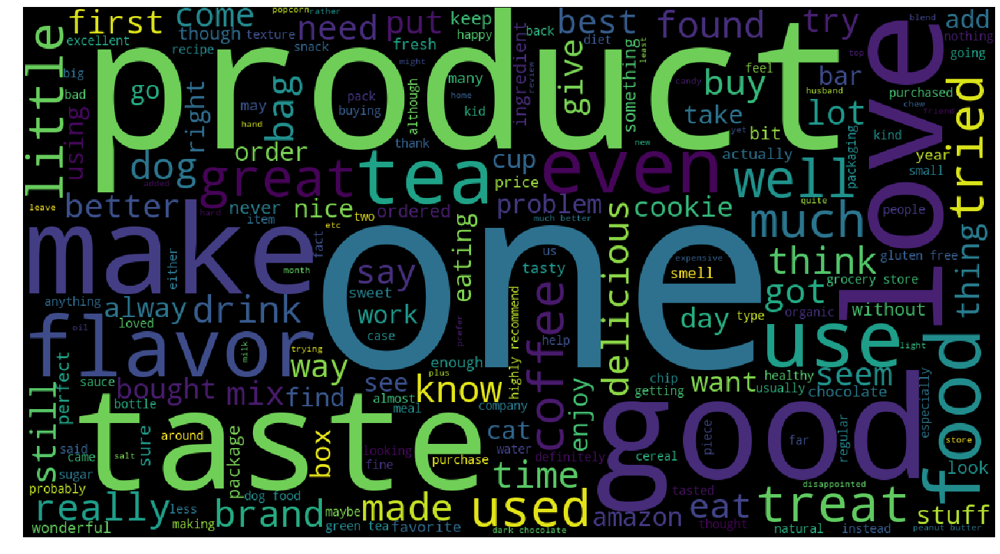

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization : 0.23


In [57]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(AW2V_length_C0_DBSCAN))
print(" ")
print("Cluster 0 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C0_DBSCAN)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 579
 
Cluster 1 obtained by Avg W2V Featurization:


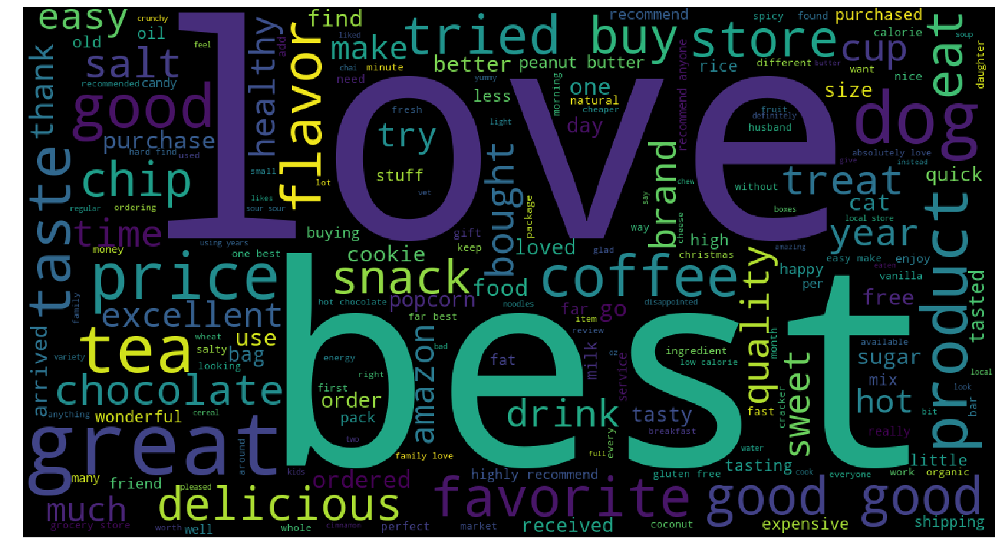

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization : 0.03


In [58]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(AW2V_length_C1_DBSCAN))
print(" ")
print("Cluster 1 obtained by Avg W2V Featurization:")

Show_Wordcloud(AW2V_indices_C1_DBSCAN)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

# [5.3.3] Applying DBSCAN Clustering on TFIDF W2V :-

# Hyperparameter Tuning on the Avg W2V Representation :- 

<b> <font color="black"> Calling the "nth_smallest_distance" & "sorted_distances" Functions :- </font> </b>

In [71]:
TFIDFW2V_indices,TFIDFW2V_distances = nth_smallest_distance(tfidf_sent_vectors,100,50)
TFIDFW2V_sorted_indices,TFIDFW2V_sorted_distances = sorted_distances(TFIDFW2V_distances,tfidf_sent_vectors,50)

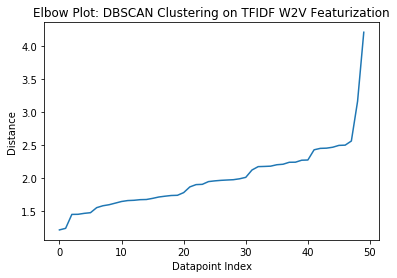

In [82]:
#Plotting Distance vs the Data Point Index for TFIDF W2V

plt.plot(TFIDFW2V_sorted_indices,TFIDFW2V_sorted_distances)

plt.xlabel('Datapoint Index')
plt.ylabel('Distance')
plt.title('Elbow Plot: DBSCAN Clustering on TFIDF W2V Featurization')

plt.show()

In the plot above, the spike occurs around distance = 2.4, which becomes our value of eps.

In [83]:
optimal_eps_TFIDFW2V = 2.4

# Training DBSCAN Algorithm on the TFIDF W2V Representation :- 

In [84]:
import time
start = time.time()

TFIDFW2V_DBSCAN_Model = DBSCAN(eps=optimal_eps_TFIDFW2V,min_samples=100)
TFIDFW2V_DBSCAN_Model.fit(tfidf_sent_vectors)    

end = time.time()
print("Time Required to Run this Code Snippet (in minutes) : "
      , np.round((end - start)/60,2))

Time Required to Run this Code Snippet (in minutes) :  8.08


In [86]:
set(TFIDFW2V_DBSCAN_Model.labels_)

{-1, 0}

Now we obtain the distinct labels after Density Based Clustering Training has been carried out on our "tfidf_sent_vectors" and we see that we get 2 class labels.

<b> <font color="black"> Calling the Review_Cluster() Function on TFIDF W2V Model:- </font> </b>

In [87]:
TFIDFW2V_C0_DBSCAN = []
TFIDFW2V_C1_DBSCAN = []

TFIDFW2V_indices_C0_DBSCAN,TFIDFW2V_length_C0_DBSCAN = Review_Cluster(TFIDFW2V_DBSCAN_Model,0,TFIDFW2V_C0_DBSCAN)
TFIDFW2V_indices_C1_DBSCAN,TFIDFW2V_length_C1_DBSCAN = Review_Cluster(TFIDFW2V_DBSCAN_Model,-1,TFIDFW2V_C1_DBSCAN)

# [5.3.4] Wordclouds of Clusters obtained after applying DBSCAN Clustering on TFIDF W2V :-

We have 2 class labels in this case as well with label = -1, and 0.

<b> <font color="black"> Obtaining Word Clouds for the Individual Clusters for TFIDF W2V Featurization on DBSCAN Clustering :- </font> </b>

Number of Reviews Classified into Cluster 0: 48156
 
Cluster 0 obtained by TFIDF W2V Featurization:


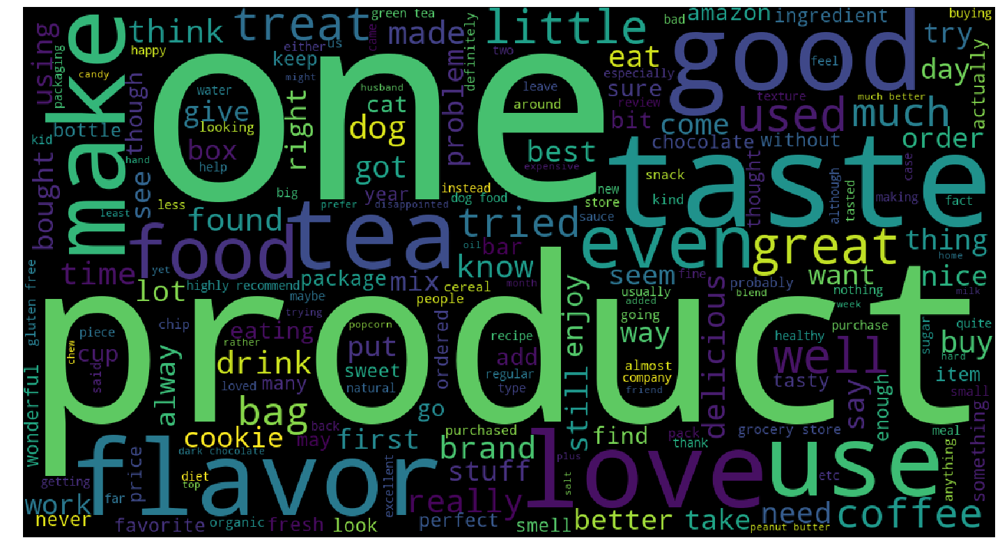

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization : 0.24


In [88]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 0: " + str(TFIDFW2V_length_C0_DBSCAN))
print(" ")
print("Cluster 0 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C0_DBSCAN)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 0 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

Number of Reviews Classified into Cluster 1: 1844
 
Cluster 1 obtained by TFIDF W2V Featurization:


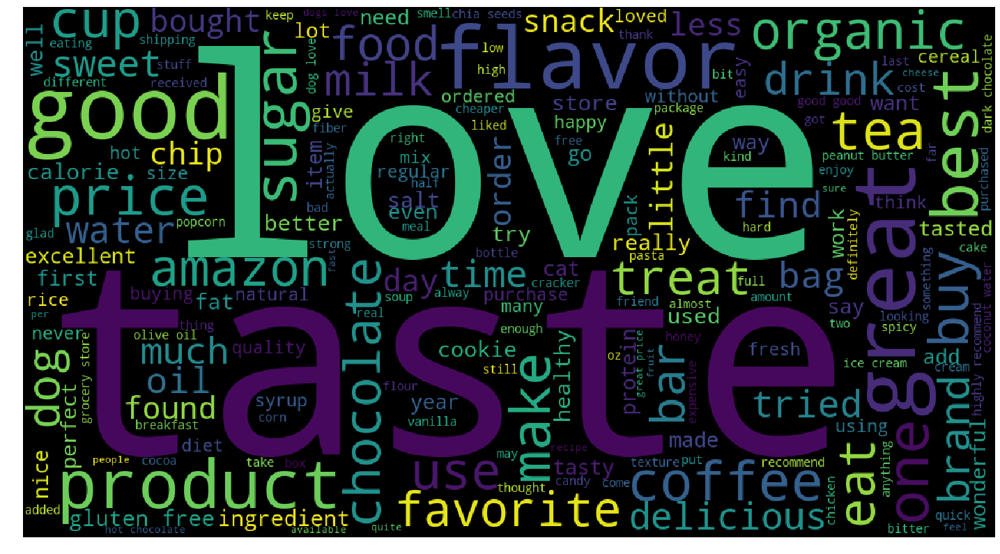

Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization : 0.04


In [89]:
import time
start = time.time()

print("Number of Reviews Classified into Cluster 1: " + str(TFIDFW2V_length_C1_DBSCAN))
print(" ")
print("Cluster 1 obtained by TFIDF W2V Featurization:")

Show_Wordcloud(TFIDFW2V_indices_C1_DBSCAN)

end = time.time()
print("Time consumed (in minutes) in obtaining the Word Cloud for the Cluster 1 obtained by TFIDF W2V Featurization :"
      , np.round((end - start)/60,2))

# [6] Conclusions

<b> <font color="black"> For K-Means Clustering :- </font> </b>

In [91]:
from prettytable import PrettyTable

a = PrettyTable()
a.field_names=["S.No.","Model","Ideal Value of K"]

In [92]:
print("Ideal Value of K for Different Featurizations using K-Means Clustering : ")
print(" "*100)

a.add_row(["1","BOW","7"])
a.add_row(["2","TFIDF","7"])
a.add_row(["3","Avg W2V","7"])
a.add_row(["4","TFIDF W2V","7"])

print(a)

Ideal Value of K for Different Featurizations using K-Means Clustering : 
                                                                                                    
+-------+-----------+------------------+
| S.No. |   Model   | Ideal Value of K |
+-------+-----------+------------------+
|   1   |    BOW    |        7         |
|   2   |   TFIDF   |        7         |
|   3   |  Avg W2V  |        7         |
|   4   | TFIDF W2V |        7         |
+-------+-----------+------------------+


<b> <font color="black"> For Agglomerative Clustering :- </font> </b>

For Agglomerative Clustering also we needed to define the number of clusters that we need to obtain at the end after which the agglomeration is stopped. Therefore in this case we developed WordClouds for Number of Clusters =2, as well as for Number of Clusters = 5.

In [98]:
b = PrettyTable()
b.field_names=["S.No.","Model","Ideal Value of K"]

In [99]:
print("Ideal Value of eps for Different Featurizations using DBSCAN Clustering : ")
print(" "*100)

b.add_row(["1","Avg W2V","2 in M1 and 5 in M2"])
b.add_row(["2","TFIDF W2V","2 in M1 and 5 in M2"])

print(b)

Ideal Value of eps for Different Featurizations using DBSCAN Clustering : 
                                                                                                    
+-------+-----------+---------------------+
| S.No. |   Model   |   Ideal Value of K  |
+-------+-----------+---------------------+
|   1   |  Avg W2V  | 2 in M1 and 5 in M2 |
|   2   | TFIDF W2V | 2 in M1 and 5 in M2 |
+-------+-----------+---------------------+


<b> <font color="black"> For DBSCAN Clustering :- </font> </b>

In [95]:
from prettytable import PrettyTable

c = PrettyTable()
c.field_names=["S.No.","Model","Number of Clusters Defined"]

In [96]:
print("Ideal Value of eps for Different Featurizations using DBSCAN Clustering : ")
print(" "*100)

c.add_row(["1","Avg W2V","2.4"])
c.add_row(["2","TFIDF W2V","2.6"])

print(c)

Ideal Value of eps for Different Featurizations using DBSCAN Clustering : 
                                                                                                    
+-------+-----------+--------------------+
| S.No. |   Model   | Ideal Value of eps |
+-------+-----------+--------------------+
|   1   |  Avg W2V  |        2.4         |
|   2   | TFIDF W2V |        2.6         |
+-------+-----------+--------------------+


<b> <font color="black"> Summary :- </font> </b>

* Here, we basically carried out Unsupervised Algorithmic implementation where we do not have the class label in our   Final Dataset but we still classify our Xi's into various groups.
* In order to do the above we take the help of Clustering schemes :- Firstly we checked the K-Means Clustering where our 50K reviews in total were clustered into 7 class labels for all Featurizations based on the Words that were present in that particular cluster. (The value of 7 is obtained by the Elbow Method.
* To understand the most important words present in the reviews (labelled as belonging to that cluster) we obtain the Word Clouds for the same, where the size of the Word represents its frequency of occurrence in reviews belonging to one cluster. :- The Most Important words are larger in size. 
* After this we carried out the same for Agglomerative Clustering, where we built our model such that finally, we obtain Number_of_clusters =2, as well as 5. However, the issue with Agglomerative Clustering is its Terrible Time Complexity. It is preferred over Divisive Clustering though. 
* Finally we carried out DBSCAN algorithm where we used the Nearest Neighbors for each point to obtain the value of eps. Minpoints, on the other hand, as a rule of thumb is taken to have a value of : - 2 * (dimensionality of the data).